In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import least_squares
import glob
import os
from matplotlib.patches import Ellipse
import matplotlib.patches as mpatches
!pip install gtsam
import gtsam
from gtsam import Pose2, noiseModel
from matplotlib.patches import Ellipse, Circle, FancyArrowPatch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 27.1/27.1 MB 69.8 MB/s eta 0:00:00


## All functions are present inside the class ImageFeatureMatching. I have included the process overview as well as functions working in comments.

# **Covariance justification**:
### *I use the residuals between inliers (the differences between the observed and projected) to estimate the measurement noise and uncertainty in the image matching. These residuals reflect how much the homography projection deviates from the true correspondences. By analyzing the residuals, I can compute their covariance, which captures the variability and uncertainty in the reprojection errors. This covariance shows how reliable or noisy the pixel measurements are.Then, using the Jacobian, I propagate this covariance (this method explained at the end for more context). This lets me quantify how uncertain the homography estimate is based on the observed errors and the poses we get from this homography transformation.*


#**Information Matrix**:
### *I take the inverse of this covariance to get the information matrix, which reflects how confident we are about each homography estimate (weights of edges in factor graph). Lower reprojection errors lead to smaller covariance, so higher information values, meaning more reliable measurements.*
### *Sequential image pairs usually have better overlap and lower errors, so they get higher weights in GTSAM. Loop closures tend to have higher uncertainty and lower weights, helping the optimizer balance trust accordingly.*

**Homography Covariance**

Residuals b/w inliers:  
$$\sigma^2 = \text{average squared error} \quad \text{("how badly do points mismatch?")}$$

Jacobian:  
$$J = \text{sensitivity matrix} \quad \text{("which H parameters matter most?")}$$

Covariance of Homography:  
$$\text{Covariance} = \sigma^2 (J^T J)^{-1} \quad \text{("uncertainty in each H parameter")}$$  
  


**Pose Covariance**

Pose $[x, y, \theta]$ is derived from homography $H$.

$$\text{Pose_Cov} = J_{\text{pose}} \cdot \text{Cov}_H \cdot J_{\text{pose}}^T$$

_If $H$ changes a little, how much does my pose change?_

Since $H$ already has some uncertainty, the pose estimate is also uncertain.  

**Final Covariance**

$$\text{new_cov} = J_1 \cdot \text{cov}_1 \cdot J_1^T + J_2 \cdot \text{cov}_2 \cdot J_2^T$$


In [ ]:
'''
read_image() -> register_image_pair() -> [normalize_images() -> feature_matching() -> ransac_homography() -> compute_covariance()] -> visualize_feature_matches()

feature_matching() => features in images (good matches)
ransac_homography() => H matrix, inliers, outliers
visualize_feature_matches => plot these inliers, outliers
homography_resiudlas() => errors b/w transformed image 1 pts and actual image 2 pts

1) feature matching and descriptors using SIFT
2) RANSAC affine partial 2D estimation using filtered SIFT features
3) using inliers and affine transformation, get residuals for covariances
4) getting pose (x,y,theta) from the affine transformation
5) relative transformation between 2 poses
6) covariance in poses, propagate covariance using Jacobian       --> used CLAUDE for covariance approach including Jacobian
7) anchor image 0, compute global poses by chaining relative transformations sequentially   --> used CLAUDE for pose transformations
8) use loop closure information from matching non-sequential images
9) build edges between nodes if sequential pairs and loop closure edges are successful
10) GTSAM optimization with Levenberg-Marquardt  --. used CLAUDE to understand GTSAM approach
'''

class ImageFeatureMatching:
    def __init__(self):
        self.sift = cv2.SIFT_create()   #Sift detector
        self.matcher = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False) #match descriptors using L2 distance
        self.homographies = []

    def read_image(self, image_paths, titles=None, show=True):
        images=[]
        for idx, image_path in enumerate(image_paths):
            image = cv2.imread(image_path)

            if image is None:
                print(f"Error: Could not load image from {image_path}")
                return None

            title = titles[idx] if titles and idx < len(titles) else f'Image{idx+1}'

            if show:
              plt.figure(figsize=(10,8))
              plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # convert BGR to RGB for correct colors
              plt.title(title)
              plt.axis('off')
              plt.show()

            images.append(image)

        return images

    def normalize_images(self, image):
        normalized = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)
        return normalized

    ## SIFT Detector
    def feature_matching(self, image1, image2, ratio_threshold=0.8):
        normalized_image1 = self.normalize_images(image1)
        normalized_image2 = self.normalize_images(image2)

        keypoints1, descriptors1 = self.sift.detectAndCompute(normalized_image1, None)
        keypoints2, descriptors2 = self.sift.detectAndCompute(normalized_image2, None)

        # if no descriptors found -> return None for all the values that this function returns
        if descriptors1 is None or descriptors2 is None:
            print('No descriptors detected in images')
            return None, None, None, None, None

        print(f'Detected {len(keypoints1)} features in 1st image')
        print(f'Detected {len(keypoints2)} features in 2nd image')

        matches = self.matcher.knnMatch(descriptors1, descriptors2, k=2) #find 2 closest neighbor descriptors from img1 -> img2

        #Lowe's ratio test
        good_matches = []
        for match_pair in matches:
            if len(match_pair) == 2:
                m, n = match_pair
                if m.distance < ratio_threshold * n.distance:
                    good_matches.append(m)

        print(f"Found {len(good_matches)} good matches after Lowe's ratio test")

        #2d coordinates of best matches
        image1_pts = np.float32([keypoints1[m.queryIdx].pt for m in good_matches]).reshape(-1, 2)
        image2_pts = np.float32([keypoints2[m.trainIdx].pt for m in good_matches]).reshape(-1, 2)

        return image1_pts, image2_pts, keypoints1, keypoints2, good_matches

    ## RANSAC
    def ransac_homography(self, image1_pts, image2_pts, image_pair=None, ransac_threshold=5.0, max_iters=2000, confidence=0.995):
        if len(image1_pts)<3 or len(image2_pts)<3:
            print("Need at least 3 point correspondences for affine partial 2D")
            return None, None

        #homography using RNASAC
        H, mask = cv2.estimateAffinePartial2D(image1_pts, image2_pts, method=cv2.RANSAC, ransacReprojThreshold=ransac_threshold, maxIters=max_iters, confidence=confidence)

        if H is None:
          print('RANSAC failed, no affine transformation')
          return None, None

        H = np.vstack((H, [0,0,1]))

        inlier_count = np.sum(mask) #total inliers
        total_matches = len(mask)   #total features

        print(f"RANSAC Results:")
        print(f"Total matches: {total_matches}")
        print(f"Inliers: {inlier_count}")
        print(f"Outliers rejected: {total_matches - inlier_count}")

        self.homographies.append({'pair': image_pair if image_pair else ('ImageX', 'ImageY'), 'H': H})
        print(f"\nHomography for this pair found in RANSAC:\n{H} ")

        return H, mask

    ## Display features matched & inliers, outliers handled by RANSAC
    def visualize_feature_matches(self, image1, image2, keypoints1, keypoints2, matches, mask=None):
        if mask is not None:
            matches_mask = mask.ravel().tolist()  # mask matrix fro RANSAC to 1D list of 0/1 values (outlier/inlier)
            #green ->inliers, blue -> outliers
            draw_params = dict(matchColor=(0, 255, 0), singlePointColor=(255, 0, 0), matchesMask=matches_mask, flags=cv2.DrawMatchesFlags_DEFAULT)
            title = f'Feature Matches - {np.sum(mask)}/{len(mask)} inliers (Green=Inliers, Blue=Outliers)'
        else:
            draw_params = dict(matchColor=(0, 0, 255), singlePointColor=(0, 255, 255), flags=cv2.DrawMatchesFlags_DEFAULT) #when no mask availabke from RANSAC => red, cyan colors for matches, points
            title = 'Features Matched'

        matched_img = cv2.drawMatches(image1, keypoints1, image2, keypoints2, matches, None, **draw_params)

        plt.figure(figsize=(15, 8))
        plt.imshow(cv2.cvtColor(matched_img, cv2.COLOR_BGR2RGB))
        plt.title(title)
        plt.axis('off')
        plt.show()

        return matched_img

    ## reprojection errors ( difference between transformed image 1 points & actual image 2 points)
    # homogeneous coordinates -> transformation -> euclidean
    def homography_residuals(self, params, image1_pts, image2_pts):
        H = np.array([[params[0], params[1], params[2]],                # params => flattened H matrix values
                      [params[3], params[4], params[5]],
                      [params[6], params[7], 1.0]])

        image1_homogeneous_coord = np.column_stack([image1_pts, np.ones(len(image1_pts))])   #converted to homogeneous coordinates Nx3

        #homography transformation -> (3x3 @ (Nx3)T )T
        transformed = (H @ image1_homogeneous_coord.T).T

        #back to euclidean coordinates(divide by w)
        z = transformed[:, 2]
        z[z == 0] = 1e-8  #avoiding division by zero
        transformed_pts = transformed[:, :2] / z.reshape(-1, 1)

        #residuals(reprojection errors)
        residuals = (image2_pts - transformed_pts).flatten()

        return residuals

    '''
    The Jacobian captures how small changes in the homography parameters (H) affect the projected points. Each row shows the sensitivity of the reprojection error (x or y) to a specific parameter of H.
    Large partial derivatives mean the output is highly sensitive to that parameter.

    # For each inlier point (x1, y1):
    # - Compute the homography projection to get (x2, y2).
    # - Calculate the denominator (w) and numerators (x2h, y2h) from H.
    # - Get partial derivatives of (x2, y2) w.r.t. the 8 homography params.
    # - Each point adds 2 rows to the Jacobian: one for x, one for y.
    '''

    def compute_jacobian(self, H_params, inlier_pts1):
      n_points = len(inlier_pts1)
      J = np.zeros((2 * n_points, 8))      #2 rows per (x,y residuals)

      for i, (x1, y1) in enumerate(inlier_pts1):
          w = H_params[6]*x1 + H_params[7]*y1 + 1.0           # w = h20*x1 + h21*y1 + 1
          w = max(abs(w), 1e-8)  # avoid division by zero

          x2_h = H_params[0]*x1 + H_params[1]*y1 + H_params[2]  # h00*x1 + h01*y1 + h02
          y2_h = H_params[3]*x1 + H_params[4]*y1 + H_params[5]  # h10*x1 + h11*y1 + h12

          # Row 2*i: derivatives of x-residual
          # residual_x = x2_true - x2_h/w
          # ∂residual_x/∂param = -∂(x2_h/w)/∂param
          J[2*i, 0] = -x1 / w                           # ∂r_x/∂h00
          J[2*i, 1] = -y1 / w                           # ∂r_x/∂h01
          J[2*i, 2] = -1.0 / w                          # ∂r_x/∂h02
          J[2*i, 3] = 0.0                               # h10, h11, h12 don't affect x2_h
          J[2*i, 4] = 0.0
          J[2*i, 5] = 0.0
          J[2*i, 6] = x2_h * x1 / (w * w)               # ∂r_x/∂h20
          J[2*i, 7] = x2_h * y1 / (w * w)               # ∂r_x/∂h21

          # Row 2*i+1: derivatives of y-residual
          # residual_y = y2_true - y2_h/w
          # ∂residual_y/∂param = -∂(y2_h/w)/∂param
          J[2*i+1, 0] = 0.0                             # h00, h01, h02 don't affect y2_h
          J[2*i+1, 1] = 0.0
          J[2*i+1, 2] = 0.0
          J[2*i+1, 3] = -x1 / w                         # ∂r_y/∂h10
          J[2*i+1, 4] = -y1 / w                         # ∂r_y/∂h11
          J[2*i+1, 5] = -1.0 / w                        # ∂r_y/∂h12
          J[2*i+1, 6] = y2_h * x1 / (w * w)             # ∂r_y/∂h20
          J[2*i+1, 7] = y2_h * y1 / (w * w)             # ∂r_y/∂h21

      return J

    # Homography parameters covariance
    def compute_covariance(self, H_ransac, inlier_image1, inlier_image2):
        if H_ransac is None or len(inlier_image1) < 4:
            print("Not enough inliers")
            return None

        H_flat = H_ransac.flatten()[:8]
        residuals = self.homography_residuals(H_flat, inlier_image1, inlier_image2)
        sigma2 = np.mean(residuals**2)
        print(f" Residual sigma2: {sigma2:.2f}, sqrt: {np.sqrt(sigma2):.2f} pixels")

        J = self.compute_jacobian(H_flat, inlier_image1)

        try:
            JtJ = J.T @ J
            return sigma2 * np.linalg.inv(JtJ)
        except np.linalg.LinAlgError:
            print("adding regularization, Singular Jacobian Matrix")
            JtJ += 1e-8 * np.eye(8)
            return sigma2 * np.linalg.inv(JtJ)

    def register_image_pair(self, image1, image2, visualize=True):
        # SIFT
        result = self.feature_matching(image1, image2)
        if result[0] is None:
            return {'success': False, 'error': 'Feature matching failed'}

        image1_pts, image2_pts, keypoints1, keypoints2, good_matches = result

        # RANSAC
        H_ransac, mask = self.ransac_homography(image1_pts, image2_pts)
        if H_ransac is None:
            return {'success': False, 'error': 'RANSAC failed'}

        inlier_mask = mask.ravel() == 1
        inlier_image1 = image1_pts[inlier_mask]
        inlier_image2 = image2_pts[inlier_mask]

        #Covariance
        covariance_matrix = self.compute_covariance(H_ransac, inlier_image1, inlier_image2)

        if visualize:
            self.visualize_feature_matches(image1, image2, keypoints1, keypoints2, good_matches, mask)

        matching_result = {
            'success': True,
            'homography_ransac': H_ransac,
            'inlier_mask': mask,
            'inlier_points_image1': inlier_image1,
            'inlier_points_image2': inlier_image2,
            'total_matches': len(good_matches),
            'inlier_count': np.sum(mask),
            'inlier_ratio': np.sum(mask) / len(good_matches),
            'covariance_matrix': covariance_matrix,
            'keypoints1': keypoints1,
            'keypoints2': keypoints2,
            'good_matches': good_matches
        }

        print(f"\nImage Feature Matching done")
        print(f"Final inlier ratio: {matching_result['inlier_ratio']:.2%}")

        return matching_result

    # loop closure using non-sequential matches
    def extract_loop_closures(self, non_sequential_results, min_inlier_ratio=0.4):
        loop_closures = []
        rejected_count = 0

        for result_dict in non_sequential_results:
            if result_dict['success']:
                inlier_ratio = result_dict['result']['inlier_ratio']

                if inlier_ratio >= min_inlier_ratio:
                    loop_closures.append({
                        'pair': result_dict['pair'],
                        'measurement': self.homography_to_pose(result_dict['result']['homography_ransac']),
                        'covariance': self.pose_covariance(
                              result_dict['result']['covariance_matrix'],
                              result_dict['result']['homography_ransac']
                          ),
                        'edge_type': 'loop_closure',
                        'inlier_ratio': inlier_ratio,
                        'inlier_count': result_dict['result']['inlier_count']
                    })
                else:
                    rejected_count += 1
                    print(f"Rejected Loop closure {result_dict['pair_name']}: {inlier_ratio:.1%} inliers")

        return loop_closures

    '''
    pose from H_ransac -> it's uncertainty (covariance) individually and relative too-> relative transformations in 2 poses -> anchor image0 and then these relative transformation from earlier

    Homography covariance => how uncertain are my H parameters
    Pose covariance => how uncertain is my relative pose (bcoz we extract pose from uncertain H ) => for edges(using Informatix matrix)
    Global covariance => how uncertain is camera position in world coordinates => ellipse around node
    '''

    # pose (x,y,theta) from homography
    def homography_to_pose(self, H_ransac):
        H_norm = H_ransac / H_ransac[2,2]
        x,y = -H_norm[0,2], H_norm[1,2]

        R = H_norm[:2, :2]
        theta = np.arctan2(R[1,0], R[0,0])

        return np.array([x, y, theta])

    #relative transformations using pose to place in world frame
    def pose_compose(self, pose1, pose2):
        x1, y1, theta1 = pose1
        x2, y2, theta2 = pose2

        # Rotation matrix from pose1
        R1 = np.array([
            [np.cos(theta1), -np.sin(theta1)],
            [np.sin(theta1),  np.cos(theta1)]
        ])

        # Rotate and translate
        xy = np.dot(R1, np.array([x2, y2])) + np.array([x1, y1])
        theta = theta1 + theta2
        theta = (theta + np.pi) % (2 * np.pi) - np.pi  # normalize angle to [-pi, pi]

        return np.array([xy[0], xy[1], theta])

    # pose covariance from homography covariance (which we got from RANSAC using inliers, residuals)
    def pose_covariance(self, covariance_matrix, H_ransac):
        if covariance_matrix is None:
          return np.eye(3) * 1.0   #diagonal matrix incase none

        # Normalize homography
        H_norm = H_ransac / H_ransac[2, 2]

        # Jacobian of pose extraction: d[x,y,θ]/d[h00,h01,h02,h10,h11,h12,h20,h21]
        J_pose = np.zeros((3, 8))

        # Translation derivatives
        J_pose[0, 2] = -1.0  # ∂x/∂h02
        J_pose[1, 5] = 1.0  # ∂y/∂h12

        # Rotation derivatives (from atan2(h10, h00))
        h00, h10 = H_norm[0, 0], H_norm[1, 0]
        denominator = h00**2 + h10**2

        if denominator > 1e-8:
            J_pose[2, 0] = -h10 / denominator  # ∂θ/∂h00
            J_pose[2, 3] = h00 / denominator   # ∂θ/∂h10

        # First-order uncertainty propagation
        pose_cov = J_pose @ covariance_matrix @ J_pose.T
        pose_cov = pose_cov / 50   #scaling down values as covariance is large due to strong XY correlations b/w adjacent images which are relatively close (later get optimized in gtsam).

        return pose_cov


    # propagate covariance during pose composition
    def propagate_covariance(self, pose1, cov1, pose2, cov2):
        x1, y1, theta1 = pose1
        x2, y2, theta2 = pose2

        J1 = np.array([
            [1, 0, -np.sin(theta1)*x2 - np.cos(theta1)*y2],
            [0, 1,  np.cos(theta1)*x2 - np.sin(theta1)*y2],
            [0, 0, 1]
        ])

        J2 = np.array([
            [np.cos(theta1), -np.sin(theta1), 0],
            [np.sin(theta1),  np.cos(theta1), 0],
            [0, 0, 1]
        ])

        cov_new = J1 @ cov1 @ J1.T + J2 @ cov2 @ J2.T
        return cov_new

    #compose pose and covariance
    def compose_pose_with_covariance(self, pose1, cov1, pose2, cov2):
      new_pose = self.pose_compose(pose1, pose2)
      new_cov  = self.propagate_covariance(pose1, cov1, pose2, cov2)
      return new_pose, new_cov

    # global pose using relative pose from first node at (0,0,0)
    def global_poses_and_covariances(self, relative_poses, relative_covariances):
        global_poses = [np.array([0.0, 0.0, 0.0])]  #image 1

        # Initial uncertainty
        initial_uncertainty = {
            'x': 1.5,      # pixels
            'y': 1.5,      # pixels
            'theta': 1.0   # degrees
        }

        initial_cov = np.diag([
            initial_uncertainty['x']**2,
            initial_uncertainty['y']**2,
            (initial_uncertainty['theta'] * np.pi/180)**2  # Convert degrees to radians
        ])

        global_covariances = [initial_cov]

        '''
        rel_pose 1 => image 1 -> 2
        rel_pose 2 => image 2 -> 3

        relative_pose = homography_to_pose (basically pose b/w img1 and 2)
        relative_covariance = pose_covariance of this relative pose

        global pose = prev img pose + relative pose
        global covariance = prev img covariance + relative covariance

        '''
        for rel_pose, rel_cov in zip(relative_poses, relative_covariances):
            new_pose, new_cov = self.compose_pose_with_covariance(
                global_poses[-1], global_covariances[-1], rel_pose, rel_cov
            )
            # new_cov = np.diag(np.diag(new_cov))
            global_poses.append(new_pose)
            global_covariances.append(new_cov)

        return global_poses, global_covariances

    def build_edges(self, sequential_results, non_sequential_results=None, min_inlier_ratio=0.4):
        edges = []

        # Sequential edges
        for i, result_dict in enumerate(sequential_results):
            if result_dict['success']:
                rel_pose = self.homography_to_pose(result_dict['result']['homography_ransac'])
                pose_cov = self.pose_covariance(
                    result_dict['result']['covariance_matrix'],
                    result_dict['result']['homography_ransac']
                )
                regularized_cov = pose_cov + 1e-6 * np.eye(pose_cov.shape[0])
                info = np.linalg.inv(regularized_cov)

                edge = {
                    'from': i,
                    'to': i + 1,
                    'measurement': rel_pose,
                    'information': info,
                    'edge_type': 'sequential'
                }
                edges.append(edge)

        # Loop closure edges
        if non_sequential_results is not None:
            loop_closures = self.extract_loop_closures(non_sequential_results, min_inlier_ratio)

            for lc in loop_closures:
                i, j = lc['pair']
                regularized_cov = lc['covariance'] + 1e-6 * np.eye(lc['covariance'].shape[0])
                info = np.linalg.inv(regularized_cov)

                edge = {
                    'from': i,
                    'to': j,
                    'measurement': lc['measurement'],
                    'information': info,
                    'edge_type': 'loop_closure',
                    'inlier_ratio': lc['inlier_ratio']
                }
                edges.append(edge)

        return edges

#############
## MOSAIC

    def warp_images_to_mosaic(self, images, transformations, canvas_width, canvas_height, translation):
        mosaic = np.zeros((canvas_height, canvas_width, 3), dtype=np.float32)  # Use float32 for blending

        for i, (image, T) in enumerate(zip(images, transformations)):
            T_final = translation @ T
            warped = cv2.warpPerspective(image.astype(np.float32), T_final, (canvas_width, canvas_height))
            mask = np.any(warped > 0, axis=2).astype(np.uint8) #for distance transform (for soft edges)

            #soft blend
            dist_transform = cv2.distanceTransform(mask, cv2.DIST_L2, 5)  #soft edge
            edge_width = 20  # softness b/w transitions
            alpha = np.ones_like(dist_transform, dtype=np.float32)
            edge_pixels = dist_transform < edge_width
            alpha[edge_pixels] = dist_transform[edge_pixels] / edge_width
            alpha = np.clip(alpha, 0.3, 1.0)

            # apply soft blending
            current_mask = np.any(warped > 0, axis=2)
            for c in range(3):  # For each color channel
                mosaic[:, :, c][current_mask] = (
                    alpha[current_mask] * warped[:, :, c][current_mask] +
                    (1 - alpha[current_mask]) * mosaic[:, :, c][current_mask]
                )

        return np.clip(mosaic, 0, 255).astype(np.uint8)

    #canvas size function
    def calculate_canvas_bounds(self, images, transformations, padding=50):
        all_corners = []

        for i, (image, T) in enumerate(zip(images, transformations)):
            h, w = image.shape[:2]
            corners = np.array([[0,0,1], [w,0,1], [w,h,1], [0,h,1]], dtype=np.float32)

            #transform corners
            transformed_corners_h = (T @ corners.T).T

            #euclidean coordinates
            z = transformed_corners_h[:, 2]
            z[z == 0] = 1e-8
            transformed_corners = transformed_corners_h[:, :2] / z.reshape(-1, 1)

            all_corners.extend(transformed_corners)

        # canvas size
        all_corners = np.array(all_corners)
        min_x, min_y = np.floor(all_corners.min(axis=0)).astype(int) - padding
        max_x, max_y = np.ceil(all_corners.max(axis=0)).astype(int) + padding

        canvas_width = max_x - min_x
        canvas_height = max_y - min_y

        #translation to positive coordinates
        translation = np.array([[1, 0, -min_x], [0, 1, -min_y], [0, 0, 1]], dtype=np.float64)

        print(f"Canvas size: {canvas_width} x {canvas_height}")

        return canvas_width, canvas_height, translation

    # image i <- image 1 by caclulating image 1 -> image i transform matrix then inversing it
    def transformation_sequence(self, sequential_results):
        homographies = []

        #return Identity if no H matrix found
        for i, result_dict in enumerate(sequential_results):
            if result_dict['success']:
                H = result_dict['result']['homography_ransac'].astype(np.float64)
                homographies.append(H)
            else:
                print(f"Failed pair {i+1}-{i+2}, using identity")
                homographies.append(np.eye(3))

        num_images = len(sequential_results) + 1

        H_transforms = {}

        #image 1 reference
        H_transforms[0] = homographies[0] if len(homographies) > 0 else np.eye(3)

        for i in range(1, num_images):
            H_chain = np.eye(3)
            # chain backwards from image i to image 1
            for j in range(i-1, -1, -1):
                if j < len(homographies):
                    H_chain = np.linalg.inv(homographies[j]) @ H_chain
            H_transforms[i] = H_chain

        #list
        transformations = []
        for i in range(num_images):
            if i in H_transforms:
                transformations.append(H_transforms[i])
            else:
                transformations.append(np.eye(3))

        return transformations

    def create_mosaic_with_image1_reference(self, images, sequential_results):
        print("Creating mosaic with Image 1 as reference...")

        transformations = self.transformation_sequence(sequential_results)
        canvas_width, canvas_height, translation = self.calculate_canvas_bounds(images, transformations)
        mosaic = self.warp_images_to_mosaic(images, transformations, canvas_width, canvas_height, translation)

        return mosaic

#############
# FACTOR GRAPH

    def plot_complete_factor_graph(self, sequential_results, non_sequential_results, save_path=None):
        print("Creating factor graph before optimization")

        # extract sequential poses and covariances
        sequential_poses = []
        sequential_covariances = []

        for i, result_dict in enumerate(sequential_results):
            if result_dict['success']:                                                          #only use the sequential pair, if the result is success
                pose = self.homography_to_pose(result_dict['result']['homography_ransac'])      #pose
                pose_cov = self.pose_covariance(                                                #covariance of this pose (using H_ransac and it's covariance)
                    result_dict['result']['covariance_matrix'],
                    result_dict['result']['homography_ransac']
                )
                sequential_poses.append(pose)
                sequential_covariances.append(pose_cov)
            else:
                # fallback for failed matches
                sequential_poses.append(np.array([0.0, 0.0, 0.0]))
                sequential_covariances.append(np.eye(3) * 10.0)
                print(f"Sequential {i}-{i+1}: FAILED")

        # global poses and covariances
        global_poses, global_covariances = self.global_poses_and_covariances(
            sequential_poses, sequential_covariances
        )

        print("\nNode positions before GTSAM optimization:")
        for i, pose in enumerate(global_poses):
            x, y, theta = pose
            print(f"Node {i+1}: ({x:.1f}, {y:.1f}, {np.degrees(theta):.1f}°)")

        print("\nInitial global pose covariances (before optimization):")
        for i, cov in enumerate(global_covariances):
          print(f"Node {i} covariance:\n{cov}\n")

        #loop closure
        loop_closures = self.extract_loop_closures(non_sequential_results, min_inlier_ratio=0.4)

        #edges
        edges = self.build_edges(sequential_results, non_sequential_results)

        #plot
        self.visualize_factor_graph(global_poses, global_covariances, loop_closures, edges, save_path)

        return {
            'vertices': global_poses,
            'vertex_covariances': global_covariances,
            'edges': edges,
            'loop_closures': loop_closures
        }

    def visualize_factor_graph(self, global_poses, global_covariances, loop_closures, edges, save_path):
        from matplotlib.patches import Ellipse

        fig, ax = plt.subplots(1, 1, figsize=(16, 12))

        #sequential edges
        sequential_edges = [e for e in edges if e['edge_type'] == 'sequential']
        for edge in sequential_edges:
            i, j = edge['from'], edge['to']
            x1, y1 = global_poses[i][:2]
            x2, y2 = global_poses[j][:2]
            ax.plot([x1, x2], [y1, y2], 'b-', linewidth=2, alpha=0.8,
                    label='Sequential Edges' if edge == sequential_edges[0] else "")

        #loop closure edges
        loop_edges = [e for e in edges if e['edge_type'] == 'loop_closure']
        for edge in loop_edges:
            i, j = edge['from'], edge['to']
            x1, y1 = global_poses[i][:2]
            x2, y2 = global_poses[j][:2]
            ax.plot([x1, x2], [y1, y2], 'r--', linewidth=1, alpha=0.9,
                    label='Loop Closures' if edge == loop_edges[0] else "")

        #nodes with uncertainty ellipses
        for i, (pose, cov) in enumerate(zip(global_poses, global_covariances)):
            x, y, theta = pose

            eigenvals, eigenvecs = np.linalg.eigh(cov[:2, :2])
            eigenvals = np.maximum(eigenvals, 0.1)
            angle = np.degrees(np.arctan2(eigenvecs[1, 0], eigenvecs[0, 0]))
            width, height = 4 * np.sqrt(eigenvals)

            ellipse = Ellipse((x, y), width, height, angle=angle,
                            facecolor='none', alpha=0.4, edgecolor='black',
                            linewidth=2, zorder=2)
            ax.add_patch(ellipse)

            circle = plt.Circle((x, y), radius=1, color='green', alpha=0.9, zorder=5)
            ax.add_patch(circle)

            ax.annotate(f'{i+1}', (x, y), fontsize=12, ha='center', va='center',
                      color='black', weight='bold', zorder=6)

        ax.set_xlabel('X Position (pixels)', fontsize=14, weight='bold')
        ax.set_ylabel('Y Position (pixels)', fontsize=14, weight='bold')
        ax.set_title('Factor Graph Before GTSAM Optimization', fontsize=16, weight='bold')
        ax.grid(True, alpha=0.3)
        ax.axis('equal')
        ax.legend()

        if save_path:
            plt.savefig(save_path, dpi=300, bbox_inches='tight')

        plt.show()

###############################
## GTSAM

    def solve_with_gtsam(self, initial_poses, edges):

        graph = gtsam.NonlinearFactorGraph()
        initial_estimate = gtsam.Values()

        #initial pose
        for i, pose in enumerate(initial_poses):
            x, y, theta = pose
            pose2d = gtsam.Pose2(x, y, theta)
            initial_estimate.insert(i, pose2d)

        #prior
        prior_noise = gtsam.noiseModel.Diagonal.Sigmas([0.1, 0.1, 0.01])
        graph.add(gtsam.PriorFactorPose2(0, gtsam.Pose2(0, 0, 0), prior_noise))

        #edges
        edges_added = 0
        for edge in edges:
            i, j = edge['from'], edge['to']
            measurement = edge['measurement']

            try:
                if edge['edge_type'] == 'sequential':
                    noise_model = gtsam.noiseModel.Diagonal.Sigmas([3.0, 3.0, 0.05])
                else:
                    noise_model = gtsam.noiseModel.Diagonal.Sigmas([8.0, 8.0, 0.15])

                rel_pose = gtsam.Pose2(measurement[0], measurement[1], measurement[2])
                graph.add(gtsam.BetweenFactorPose2(i, j, rel_pose, noise_model))
                edges_added += 1

            except Exception as e:
                print(f"Could not add edge {i}-{j}: {e}")

        #optimize
        params = gtsam.LevenbergMarquardtParams()
        params.setVerbosityLM("SILENT")  #don't print any log
        params.setMaxIterations(100)

        optimizer = gtsam.LevenbergMarquardtOptimizer(graph, initial_estimate, params)
        result = optimizer.optimize()

        # Extract optimized poses and PRINT them
        optimized_poses = []
        # print("Node positions after GTSAM optimization:")
        for i in range(len(initial_poses)):
            pose_gtsam = result.atPose2(i)
            optimized_pose = [pose_gtsam.x(), pose_gtsam.y(), pose_gtsam.theta()]
            optimized_poses.append(optimized_pose)

            x, y, theta = optimized_pose
            print(f"Node {i+1}: ({x:.1f}, {y:.1f}, {np.degrees(theta):.1f}°)")

        # Compute and PRINT marginal covariances
        marginals = gtsam.Marginals(graph, result)
        optimized_covariances = []
        print("\nMarginal Covariances per node:")
        for i in range(len(initial_poses)):
            cov_gtsam = marginals.marginalCovariance(i)
            optimized_covariances.append(cov_gtsam)
            print(f"Node {i} covariance:\n{cov_gtsam}\n")

        return optimized_poses, optimized_covariances

    def plot_after_gtsam_optimization(self, optimized_poses, optimized_covariances, edges, save_path=None):
        from matplotlib.patches import Ellipse

        fig, ax = plt.subplots(1, 1, figsize=(16, 12))

        # Plot sequential edges
        sequential_edges = [e for e in edges if e['edge_type'] == 'sequential']
        for edge in sequential_edges:
            i, j = edge['from'], edge['to']
            x1, y1 = optimized_poses[i][:2]
            x2, y2 = optimized_poses[j][:2]
            ax.plot([x1, x2], [y1, y2], 'b-', linewidth=3, alpha=0.8,
                    label='Sequential Edges' if edge == sequential_edges[0] else "")

        # Plot loop closure edges
        loop_edges = [e for e in edges if e['edge_type'] == 'loop_closure']
        for edge in loop_edges:
            i, j = edge['from'], edge['to']
            x1, y1 = optimized_poses[i][:2]
            x2, y2 = optimized_poses[j][:2]
            ax.plot([x1, x2], [y1, y2], 'r--', linewidth=2, alpha=0.9,
                    label='Loop Closures' if edge == loop_edges[0] else "")

        # plot nodes with uncertainty ellipses
        for i, (pose, cov) in enumerate(zip(optimized_poses, optimized_covariances)):
            x, y, theta = pose

            # Uncertainty ellipse
            eigenvals, eigenvecs = np.linalg.eigh(cov[:2, :2])
            eigenvals = np.maximum(eigenvals, 0.1)
            angle = np.degrees(np.arctan2(eigenvecs[1, 0], eigenvecs[0, 0]))
            width, height = 4 * np.sqrt(eigenvals)

            ellipse = Ellipse((x, y), width, height, angle=angle,
                            facecolor='none', edgecolor='black', linewidth=1, zorder=2)
            ax.add_patch(ellipse)

            # node circle
            circle = plt.Circle((x, y), radius=1.5, color='black', zorder=5)
            ax.add_patch(circle)

            # label
            ax.annotate(f'{i+1}',(x, y), fontsize=12, ha='center', va='center',
                      color='black', weight='bold', zorder=6)

        ax.set_xlabel('X Position (pixels)', fontsize=14, weight='bold')
        ax.set_ylabel('Y Position (pixels)', fontsize=14, weight='bold')
        ax.set_title('Factor Graph After GTSAM Optimization', fontsize=16, weight='bold')
        ax.grid(True, alpha=0.3)
        ax.axis('equal')
        ax.legend()

        if save_path:
            plt.savefig(save_path, dpi=300, bbox_inches='tight')

        plt.show()

    def build_pose_transformations(self, optimized_poses, sequential_results):
        relative_transforms = []

        # relative transforms between consecutive poses
        for i in range(len(optimized_poses) - 1):
            try:
                pose1 = optimized_poses[i]
                pose2 = optimized_poses[i + 1]

                #inverse of pose1
                x1, y1, theta1 = pose1

                # inv([x,y,θ]) = [-R^T * [x,y], -θ]
                cos_theta1 = np.cos(-theta1)
                sin_theta1 = np.sin(-theta1)

                x1_inv = -(cos_theta1 * x1 - sin_theta1 * y1)
                y1_inv = -(sin_theta1 * x1 + cos_theta1 * y1)
                theta1_inv = -theta1

                pose1_inv = np.array([x1_inv, y1_inv, theta1_inv])

                rel_pose = self.pose_compose(pose1_inv, pose2)

                #relative pose to transformation matrix
                x_rel, y_rel, theta_rel = rel_pose

                cos_dt = np.cos(theta_rel)
                sin_dt = np.sin(theta_rel)

                rel_transform = np.array([
                    [cos_dt, -sin_dt, -x_rel],
                    [sin_dt,  cos_dt, y_rel],
                    [0,       0,      1]
                ], dtype=np.float64)

                relative_transforms.append(rel_transform)
            except Exception as e:
                print(f"Failed to compute relative transform for pair {i} and {i+1}: {e}")
                relative_transforms.append(np.eye(3))

        num_images = len(optimized_poses)
        H_transforms = {}

        H_transforms[0] = relative_transforms[0] if len(relative_transforms) > 0 else np.eye(3)

        for i in range(1, num_images):
            H_chain = np.eye(3)
            for j in range(i - 1, -1, -1):
                if j < len(relative_transforms):
                    H_chain = np.linalg.inv(relative_transforms[j]) @ H_chain
            H_transforms[i] = H_chain

        transformations = [H_transforms[i] for i in range(num_images)]
        return transformations


    def create_mosaic_with_gtsam_poses(self, images, optimized_poses, sequential_results):
        print("Creating mosaic with GTSAM-optimized poses...")

        transformations = self.build_pose_transformations(optimized_poses, sequential_results)

        canvas_width, canvas_height, translation = self.calculate_canvas_bounds(images, transformations)
        mosaic = self.warp_images_to_mosaic(images, transformations, canvas_width, canvas_height, translation)

        return mosaic

## 6 Images

Loaded images:
1.tif
2.tif
3.tif
4.tif
5.tif
6.tif


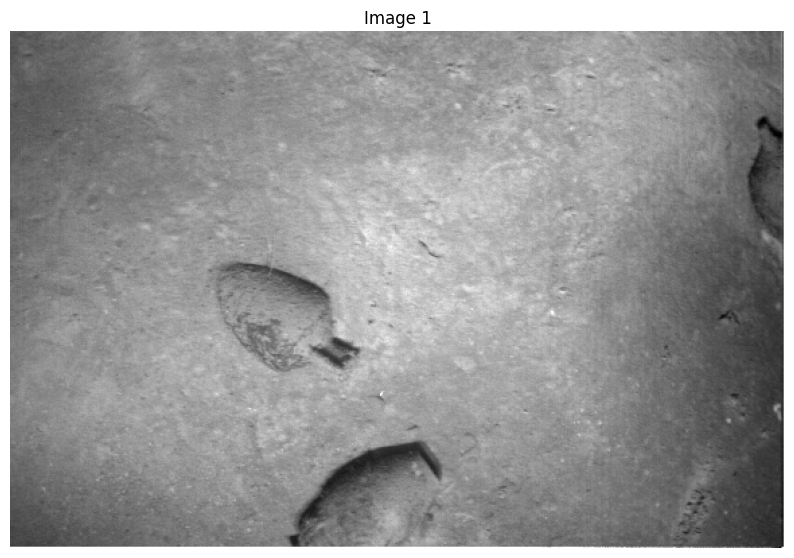

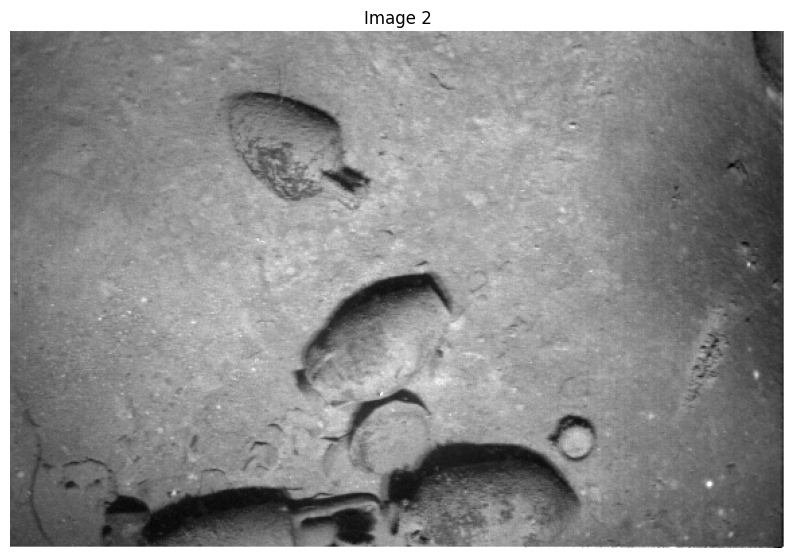

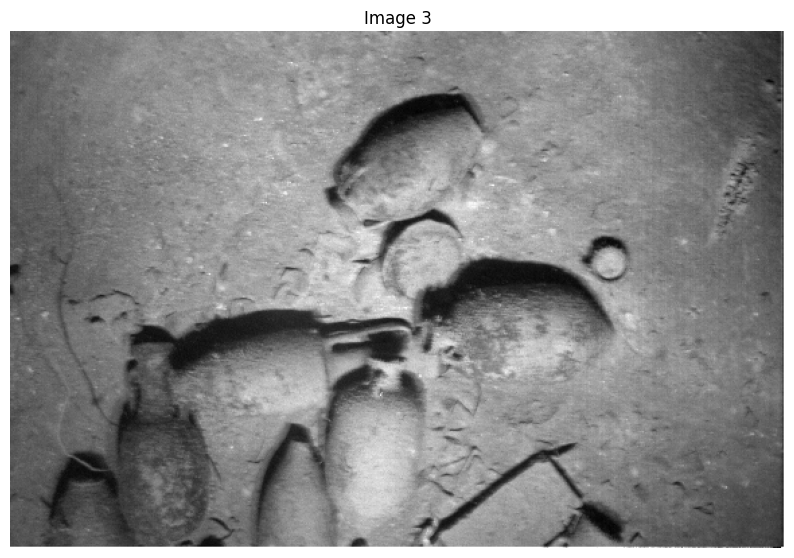

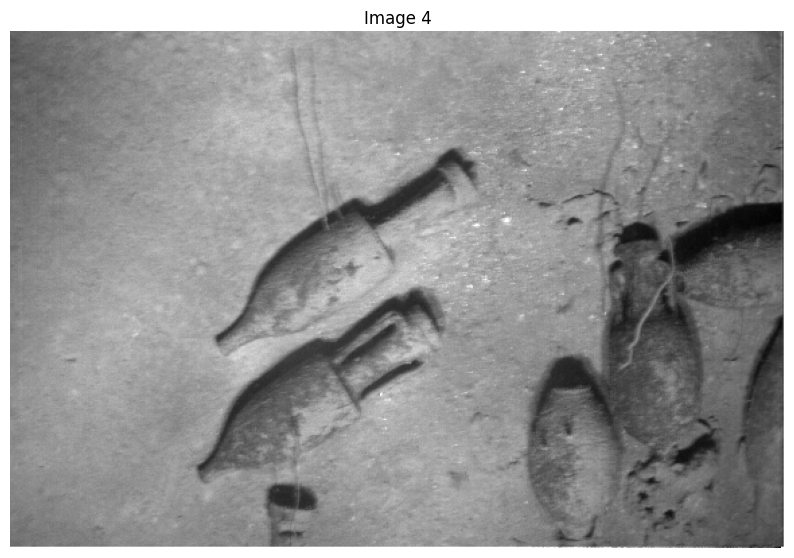

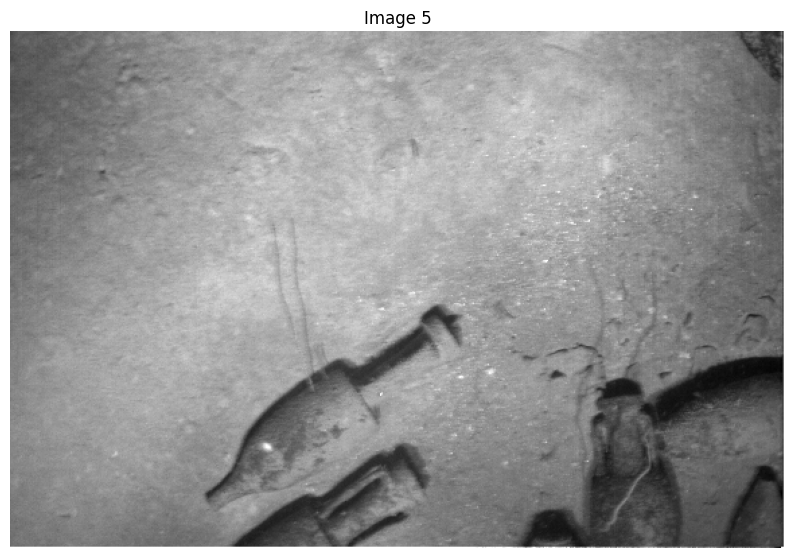

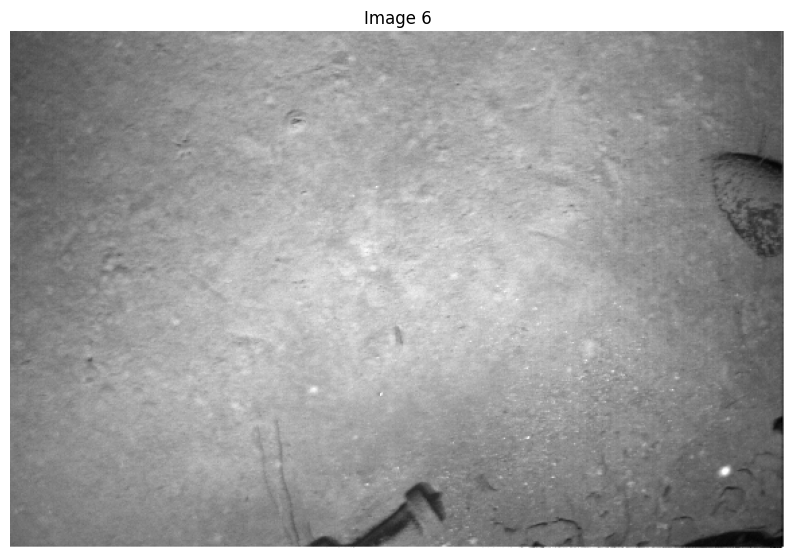

In [ ]:
matcher = ImageFeatureMatching() #class instance
image_dir = '.'
image_paths = sorted(glob.glob(os.path.join(image_dir, "*.tif")))

print("Loaded images:")
for path in image_paths:
    print(os.path.basename(path))

#read the images
images = matcher.read_image(image_paths, titles=[f"Image {i+1}" for i in range(len(image_paths))])


Matching Image 1 and Image 2
Detected 390 features in 1st image
Detected 727 features in 2nd image
Found 112 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 112
Inliers: 82
Outliers rejected: 30

Homography for this pair found in RANSAC:
[[ 9.93874710e-01 -1.93570676e-02  1.35665563e+01]
 [ 1.93570676e-02  9.93874710e-01 -1.29597314e+02]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 
 Residual sigma2: 2.57, sqrt: 1.60 pixels


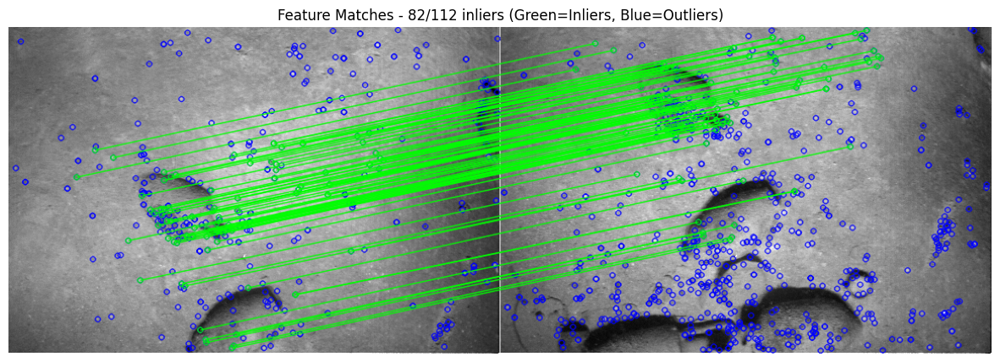


Image Feature Matching done
Final inlier ratio: 73.21%
82/112 inliers

Matching Image 2 and Image 3
Detected 727 features in 1st image
Detected 811 features in 2nd image
Found 159 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 159
Inliers: 97
Outliers rejected: 62

Homography for this pair found in RANSAC:
[[ 9.98936987e-01  1.04347804e-02  2.12495036e+01]
 [-1.04347804e-02  9.98936987e-01 -1.30034092e+02]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 
 Residual sigma2: 4.90, sqrt: 2.21 pixels


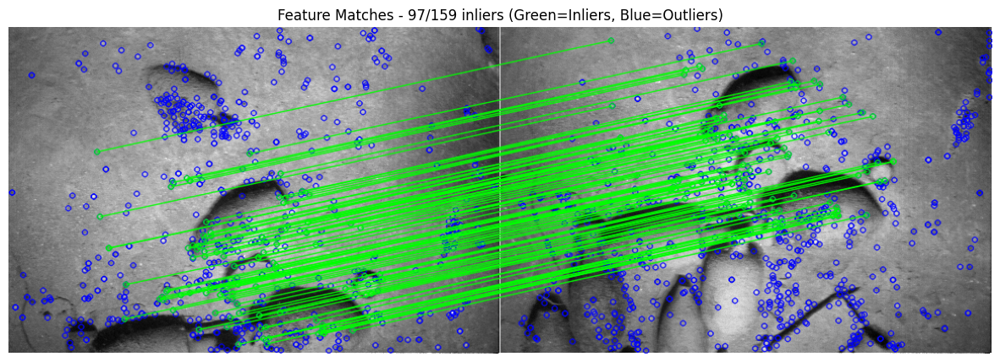


Image Feature Matching done
Final inlier ratio: 61.01%
97/159 inliers

Matching Image 3 and Image 4
Detected 811 features in 1st image
Detected 592 features in 2nd image
Found 45 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 45
Inliers: 9
Outliers rejected: 36

Homography for this pair found in RANSAC:
[[ 1.01067537e+00  4.30316780e-02  3.46308536e+02]
 [-4.30316780e-02  1.01067537e+00 -7.20396641e+01]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 
 Residual sigma2: 1.08, sqrt: 1.04 pixels


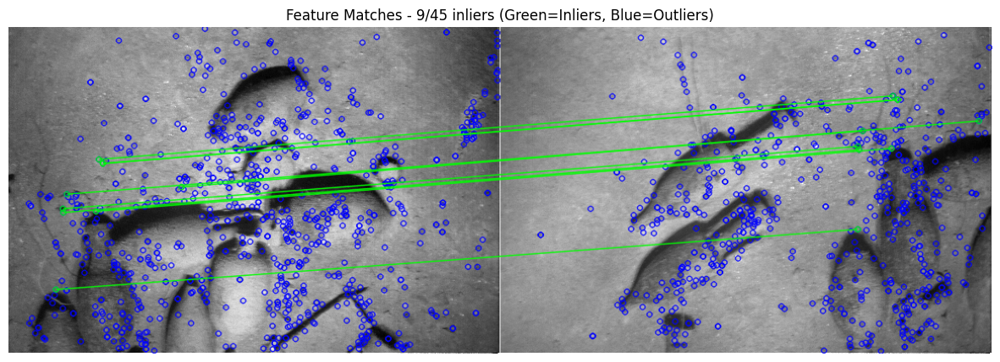


Image Feature Matching done
Final inlier ratio: 20.00%
9/45 inliers

Matching Image 4 and Image 5
Detected 592 features in 1st image
Detected 385 features in 2nd image
Found 125 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 125
Inliers: 107
Outliers rejected: 18

Homography for this pair found in RANSAC:
[[ 9.94642134e-01  1.43574614e-02 -1.18833038e+01]
 [-1.43574614e-02  9.94642134e-01  1.21206416e+02]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 
 Residual sigma2: 2.88, sqrt: 1.70 pixels


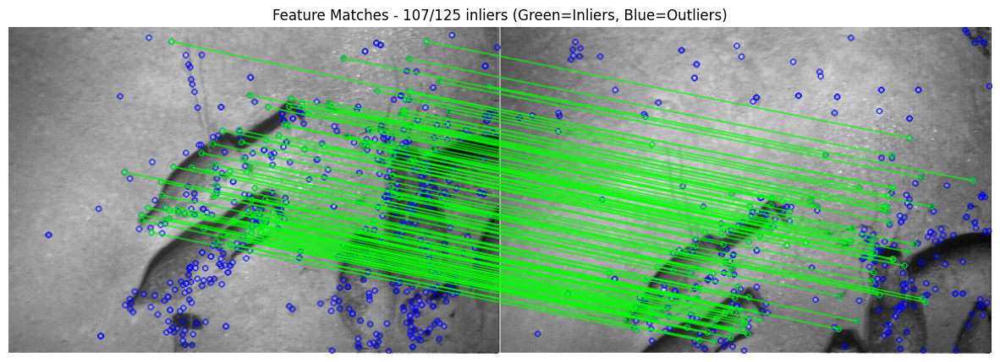


Image Feature Matching done
Final inlier ratio: 85.60%
107/125 inliers

Matching Image 5 and Image 6
Detected 385 features in 1st image
Detected 217 features in 2nd image
Found 64 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 64
Inliers: 34
Outliers rejected: 30

Homography for this pair found in RANSAC:
[[ 9.75573292e-01  2.24103998e-02 -8.67236752e+00]
 [-2.24103998e-02  9.75573292e-01  1.44758109e+02]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 
 Residual sigma2: 2.87, sqrt: 1.69 pixels


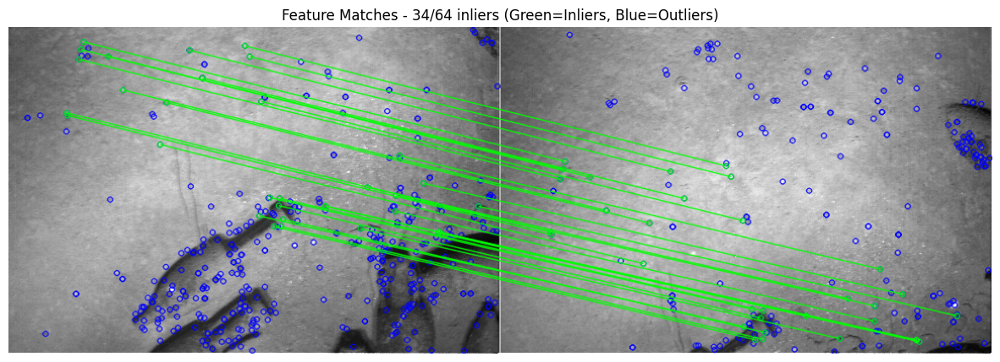


Image Feature Matching done
Final inlier ratio: 53.12%
34/64 inliers

Matching non-sequential Image 1 and Image 6
Detected 390 features in 1st image
Detected 217 features in 2nd image
Found 23 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 23
Inliers: 12
Outliers rejected: 11

Homography for this pair found in RANSAC:
[[ 1.01779455e+00  4.28559063e-02  3.58494377e+02]
 [-4.28559063e-02  1.01779455e+00 -8.11357306e+01]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 
 Residual sigma2: 1.68, sqrt: 1.29 pixels


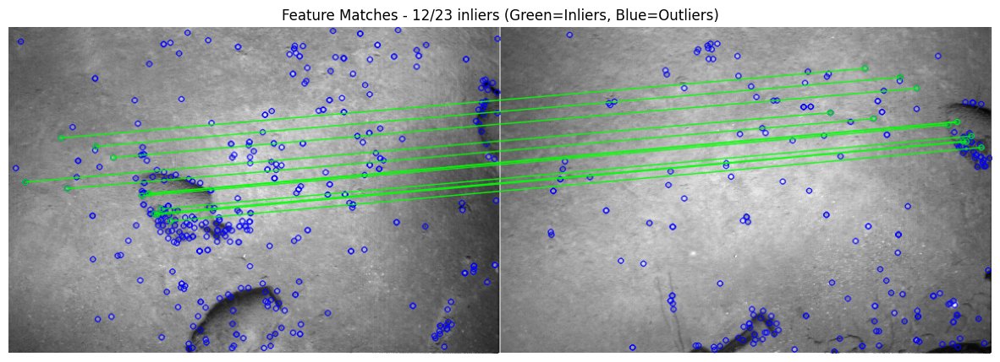


Image Feature Matching done
Final inlier ratio: 52.17%
12/23 inliers
Loop Closure done (52.2% >= 40%)

Matching non-sequential Image 2 and Image 5
Detected 727 features in 1st image
Detected 385 features in 2nd image
Found 31 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 31
Inliers: 6
Outliers rejected: 25

Homography for this pair found in RANSAC:
[[ 9.78283777e-01  6.14297111e-02  3.50771321e+02]
 [-6.14297111e-02  9.78283777e-01 -7.61809537e+01]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 
 Residual sigma2: 1.24, sqrt: 1.12 pixels


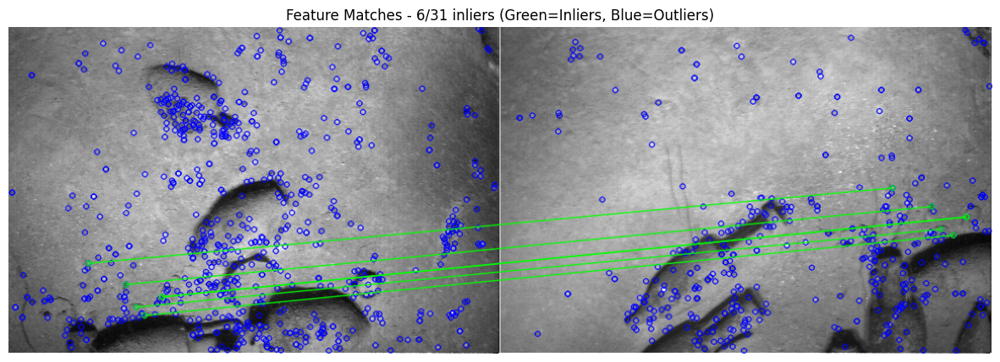


Image Feature Matching done
Final inlier ratio: 19.35%
6/31 inliers
Loop Closure not done (19.4% < 40%)

Matching non-sequential Image 2 and Image 4
Detected 727 features in 1st image
Detected 592 features in 2nd image
Found 29 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 29
Inliers: 6
Outliers rejected: 23

Homography for this pair found in RANSAC:
[[ 8.06448443e-17  6.36777276e-17  5.58267456e+02]
 [-6.36777276e-17  8.06448443e-17  1.26354324e+02]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 
 Residual sigma2: 0.00, sqrt: 0.00 pixels
adding regularization, Singular Jacobian Matrix


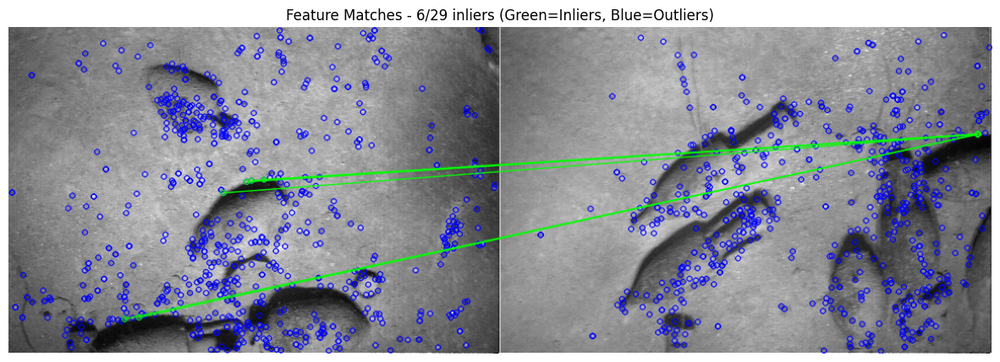


Image Feature Matching done
Final inlier ratio: 20.69%
6/29 inliers
Loop Closure not done (20.7% < 40%)

Matching non-sequential Image 3 and Image 5
Detected 811 features in 1st image
Detected 385 features in 2nd image
Found 43 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 43
Inliers: 6
Outliers rejected: 37

Homography for this pair found in RANSAC:
[[  0.          -0.         290.51931763]
 [  0.           0.         252.43482971]
 [  0.           0.           1.        ]] 
 Residual sigma2: 0.00, sqrt: 0.00 pixels


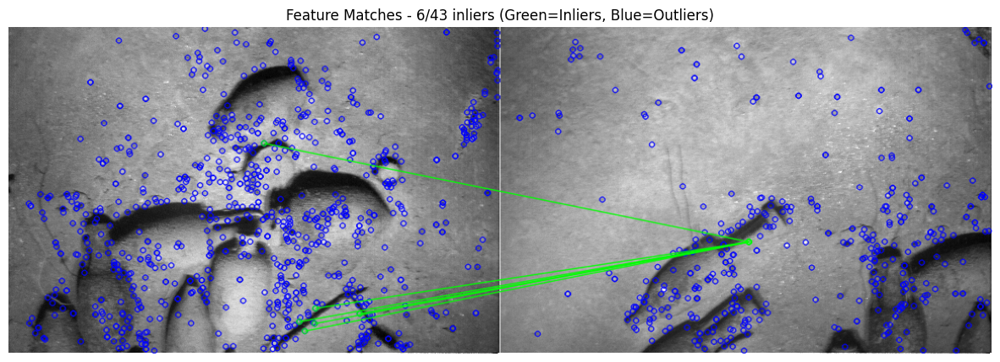


Image Feature Matching done
Final inlier ratio: 13.95%
6/43 inliers
Loop Closure not done (14.0% < 40%)

Matching non-sequential Image 1 and Image 5
Detected 390 features in 1st image
Detected 385 features in 2nd image
Found 9 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 9
Inliers: 2
Outliers rejected: 7

Homography for this pair found in RANSAC:
[[-5.82086641e-01  2.52551299e-01  6.45201902e+02]
 [-2.52551299e-01 -5.82086641e-01  4.99486963e+02]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 
Not enough inliers


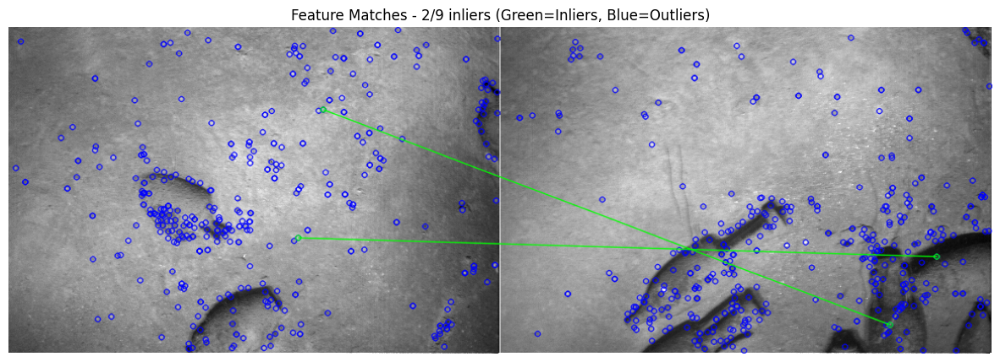


Image Feature Matching done
Final inlier ratio: 22.22%
2/9 inliers
Loop Closure not done (22.2% < 40%)

Matching non-sequential Image 2 and Image 6
Detected 727 features in 1st image
Detected 217 features in 2nd image
Found 45 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 45
Inliers: 12
Outliers rejected: 33

Homography for this pair found in RANSAC:
[[ 9.31632798e-01  6.17401066e-02  3.70758446e+02]
 [-6.17401066e-02  9.31632798e-01  6.22163611e+01]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 
 Residual sigma2: 2.11, sqrt: 1.45 pixels


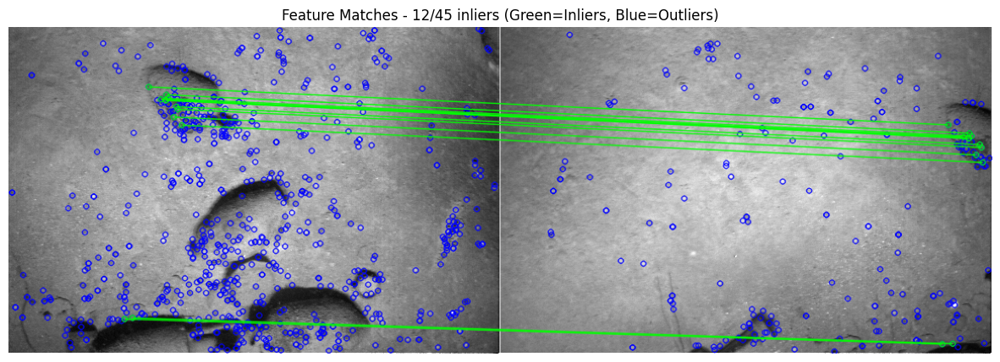


Image Feature Matching done
Final inlier ratio: 26.67%
12/45 inliers
Loop Closure not done (26.7% < 40%)

 Sequential Pairs:
  1 and 2: 73.2% (inliers: 82/112)
  2 and 3: 61.0% (inliers: 97/159)
  3 and 4: 20.0% (inliers: 9/45)
  4 and 5: 85.6% (inliers: 107/125)
  5 and 6: 53.1% (inliers: 34/64)

Non-sequential Pairs:
  1-6: 52.2% (inliers: 12/23)
  2-5: 19.4% (inliers: 6/31)
  2-4: 20.7% (inliers: 6/29)
  3-5: 14.0% (inliers: 6/43)
  1-5: 22.2% (inliers: 2/9)
  2-6: 26.7% (inliers: 12/45)

Loop Closure Pairs:
  1-6: 52.2% (inliers: 12/23)

Creating factor graph before optimization

Node positions before GTSAM optimization:
Node 1: (0.0, 0.0, 0.0°)
Node 2: (-13.6, -129.6, 1.1°)
Node 3: (-32.3, -260.0, 0.5°)
Node 4: (-377.9, -335.2, -1.9°)
Node 5: (-362.0, -214.4, -2.7°)
Node 6: (-346.4, -70.3, -4.1°)

Initial global pose covariances (before optimization):
Node 0 covariance:
[[2.2500000e+00 0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 2.2500000e+00 0.0000000e+00]
 [0.0000000e+00 0.000

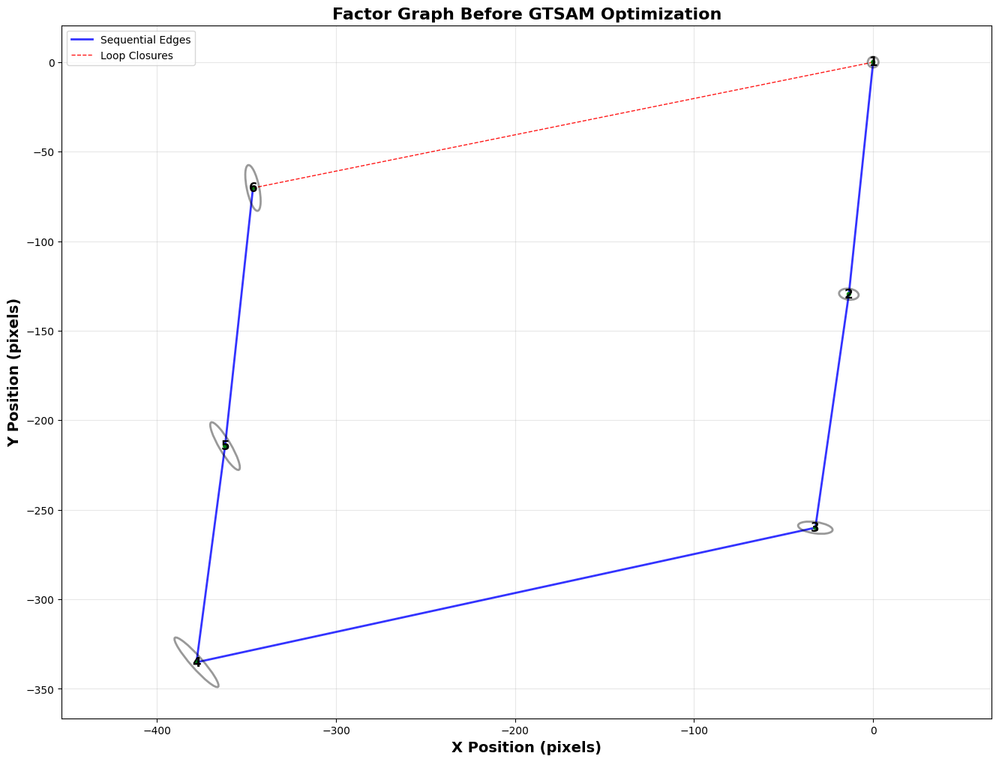

Node 1: (0.0, 0.0, -0.0°)
Node 2: (-13.8, -129.7, 1.8°)
Node 3: (-31.3, -260.4, 2.3°)
Node 4: (-374.7, -346.3, 0.7°)
Node 5: (-364.5, -225.1, 0.3°)
Node 6: (-356.8, -80.4, -1.2°)

Marginal Covariances per node:
Node 0 covariance:
[[ 1.00000000e-02 -4.01154804e-22 -2.13162821e-20]
 [-4.01154804e-22  1.00000000e-02 -3.55271368e-20]
 [-2.13162821e-20 -3.55271368e-20  1.00000000e-04]]

Node 1 covariance:
[[ 1.04405971e+01 -1.86102272e-01  1.01548001e-02]
 [-1.86102272e-01  8.89602912e+00  1.00720846e-02]
 [ 1.01548001e-02  1.00720846e-02  1.45413829e-03]]

Node 2 covariance:
[[ 4.52423839e+01 -1.68209842e+00  8.22765907e-02]
 [-1.68209842e+00  1.72166741e+01  2.96777179e-02]
 [ 8.22765907e-02  2.96777179e-02  8.63128943e-04]]

Node 3 covariance:
[[ 7.18876560e+01 -4.81044404e+01  2.18344141e-01]
 [-4.81044404e+01  9.06791820e+01 -2.14043529e-01]
 [ 2.18344141e-01 -2.14043529e-01  1.85688767e-03]]

Node 4 covariance:
[[ 4.91135490e+01 -2.16072723e+01  1.39585382e-01]
 [-2.16072723e+01  7.88

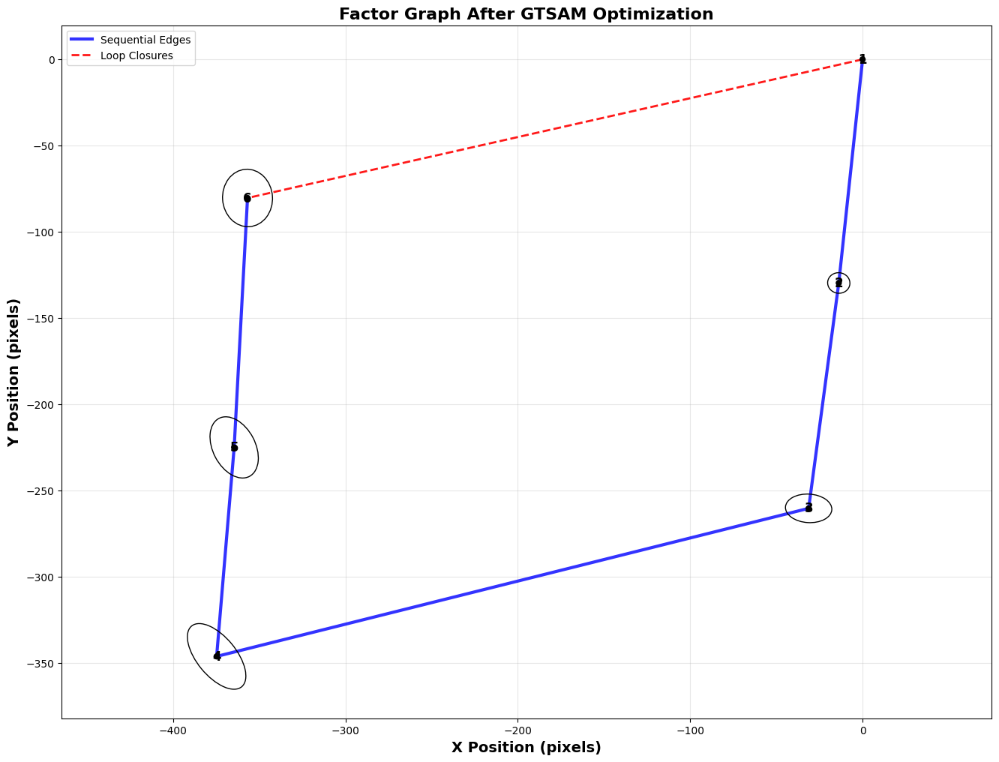

Creating mosaic with Image 1 as reference...
Canvas size: 1079 x 954
Creating mosaic with GTSAM-optimized poses...
Canvas size: 1062 x 952


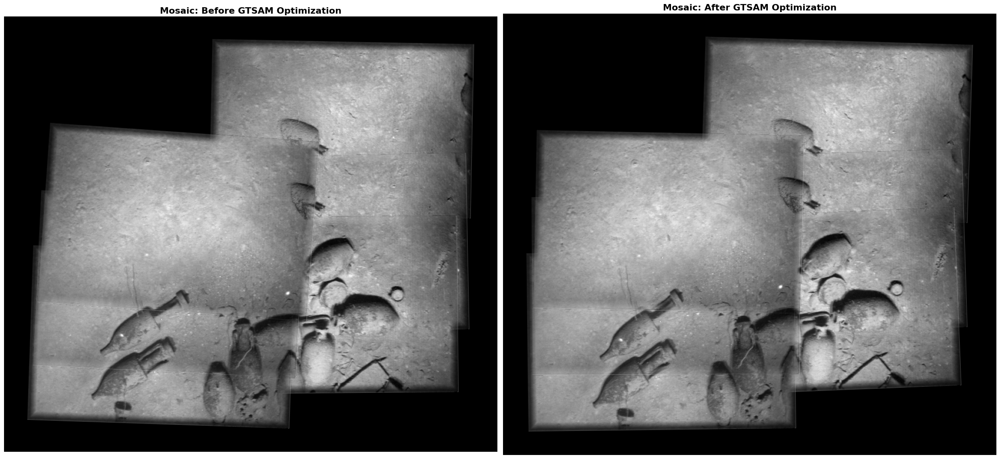

In [ ]:
# SEQUENTIAL MATCHING
sequential_results = []
successful_pairs = 0

for i in range(len(images) - 1):
    print(f"\nMatching Image {i+1} and Image {i+2}")
    try:
        result = matcher.register_image_pair(images[i], images[i + 1], visualize=True)

        # if result => success
        success = result['success']
        if success:
            successful_pairs += 1
            print(f"{result['inlier_count']}/{result['total_matches']} inliers")
        else:
            print(f"Failed: {result['error']}")

        sequential_results.append({
            'pair': (i, i+1),
            'pair_name': f"{i+1}-{i+2}",
            'result': result,
            'success': success
        })

    except Exception as e:
        print(f"Exception occurred: {e}")
        sequential_results.append({
            'pair': (i, i+1),
            'pair_name': f"{i+1}-{i+2}",
            'result': {'success': False, 'error': str(e)},
            'success': False
        })

###################################
# NON-SEQUENTIAL MATCHING

non_sequential_pairs = [(0, 5), (1, 4), (1, 3), (2, 4), (0, 4), (1, 5)]  # 0-based index
non_sequential_results = []
loop_closure_pairs = 0
min_inlier_ratio = 0.4

for idx, (i, j) in enumerate(non_sequential_pairs):
    print(f"\nMatching non-sequential Image {i+1} and Image {j+1}")
    try:
        result = matcher.register_image_pair(images[i], images[j], visualize=True)

        # Check both success AND inlier ratio threshold
        if result['success'] and result['inlier_ratio'] >= min_inlier_ratio:
            loop_closure_pairs += 1
            print(f"{result['inlier_count']}/{result['total_matches']} inliers")
            print(f"Loop Closure done ({result['inlier_ratio']:.1%} >= {min_inlier_ratio:.0%})")
            is_loop_closure = True
        elif result['success']:
            print(f"{result['inlier_count']}/{result['total_matches']} inliers")
            print(f"Loop Closure not done ({result['inlier_ratio']:.1%} < {min_inlier_ratio:.0%})")
            is_loop_closure = False
        else:
            print(f"Failed: {result['error']}")
            is_loop_closure = False

        non_sequential_results.append({
            'pair': (i, j),
            'pair_name': f"{i+1}-{j+1}",
            'result': result,
            'success': result['success'] and result['inlier_ratio'] >= min_inlier_ratio,  # ← Combined criteria
            'is_potential_loop_closure': is_loop_closure
        })

    except Exception as e:
        print(f"Exception occurred: {e}")
        non_sequential_results.append({
            'pair': (i, j),
            'pair_name': f"{i+1}-{j+1}",
            'result': {'success': False, 'error': str(e)},
            'success': False,
            'is_potential_loop_closure': False
        })

## Summary
print("\n Sequential Pairs:")
for i, pair_info in enumerate(sequential_results):
    if pair_info['success']:
        result = pair_info['result']
        ratio = result['inlier_ratio']
        count = result['inlier_count']
        total = result['total_matches']
        print(f"  {i+1} and {i+2}: {ratio:.1%} (inliers: {count}/{total})")

print("\nNon-sequential Pairs:")
for pair_info in non_sequential_results:
    name = pair_info['pair_name']
    if pair_info['result']['success']:
        result = pair_info['result']
        ratio = result['inlier_ratio']
        count = result['inlier_count']
        total = result['total_matches']
        print(f"  {name}: {ratio:.1%} (inliers: {count}/{total})")

print("\nLoop Closure Pairs:")
for pair_info in non_sequential_results:
    if pair_info['success']:  # Only accepted ones
        name = pair_info['pair_name']
        result = pair_info['result']
        ratio = result['inlier_ratio']
        count = result['inlier_count']
        total = result['total_matches']
        print(f"  {name}: {ratio:.1%} (inliers: {count}/{total})\n")

###################################
# FACTOR GRAPH

factor_graph_data = matcher.plot_complete_factor_graph(
    sequential_results,
    non_sequential_results,
    save_path='factor_graph_before_gtsam.png')

###################################
# GTSAM OPTIMIZATION

optimized_poses, optimized_covariances = matcher.solve_with_gtsam(
    factor_graph_data['vertices'],
    factor_graph_data['edges']
)

matcher.plot_after_gtsam_optimization(
    optimized_poses,
    optimized_covariances,
    factor_graph_data['edges'],
    save_path='factor_graph_after_gtsam.png'
)

mosaic = matcher.create_mosaic_with_image1_reference(images, sequential_results)

optimized_mosaic = matcher.create_mosaic_with_gtsam_poses(images, optimized_poses, sequential_results)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(25, 12))

ax1.imshow(cv2.cvtColor(mosaic, cv2.COLOR_BGR2RGB))
ax1.set_title('Mosaic: Before GTSAM Optimization', fontsize=16, weight='bold')
ax1.axis('off')

ax2.imshow(cv2.cvtColor(optimized_mosaic, cv2.COLOR_BGR2RGB))
ax2.set_title('Mosaic: After GTSAM Optimization', fontsize=16, weight='bold')
ax2.axis('off')

plt.tight_layout()
plt.show()

# 28 Images

Found 28 images in sequence:
 1: img_1.tif
 2: img_2.tif
 3: img_3.tif
 4: img_4.tif
 5: img_5.tif
 6: img_6.tif
 7: img_7.tif
 8: img_8.tif
 9: img_9.tif
10: img_10.tif
11: img_11.tif
12: img_12.tif
13: img_13.tif
14: img_14.tif
15: img_15.tif
16: img_16.tif
17: img_17.tif
18: img_18.tif
19: img_19.tif
20: img_20.tif
21: img_21.tif
22: img_22.tif
23: img_23.tif
24: img_24.tif
25: img_25.tif
26: img_26.tif
27: img_27.tif
28: img_28.tif

All 28 images found and sorted correctly.


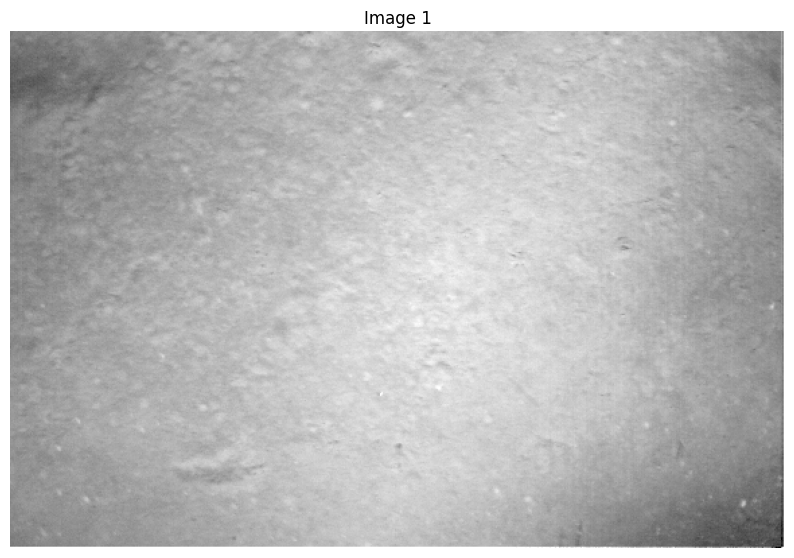

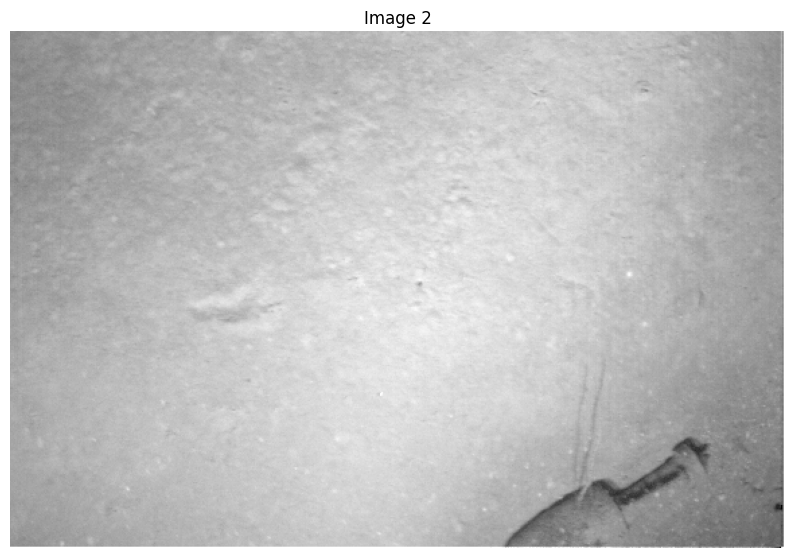

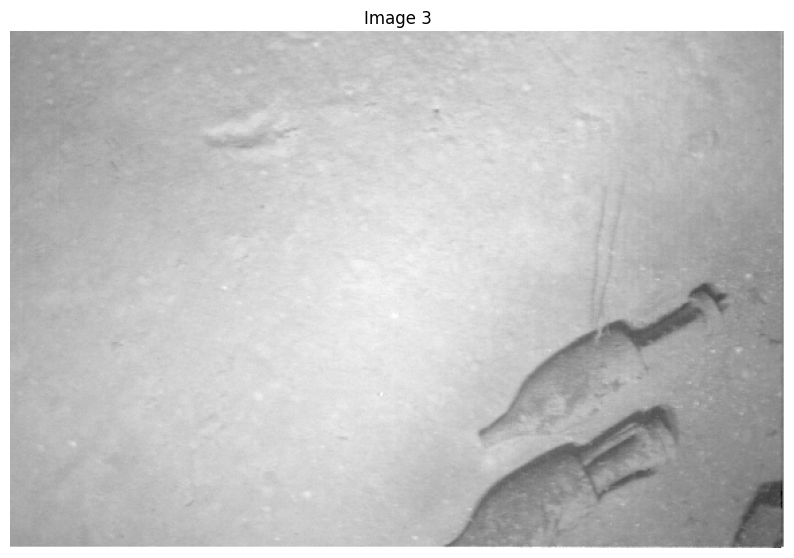

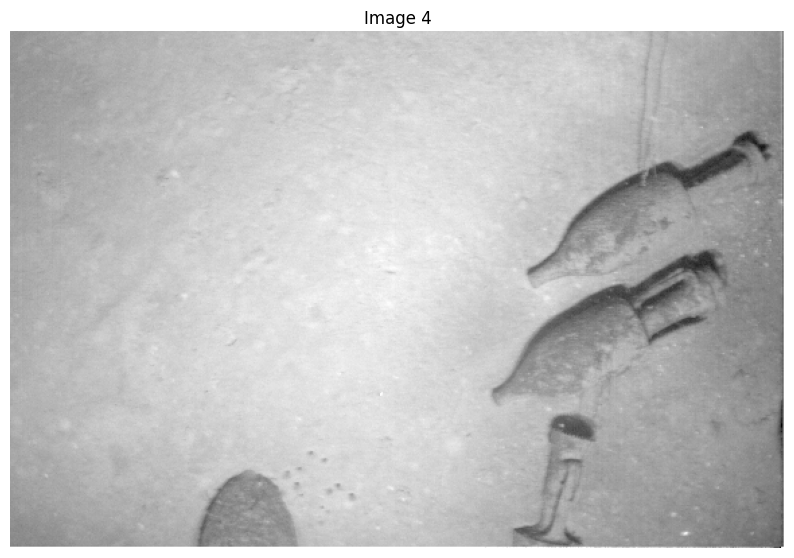

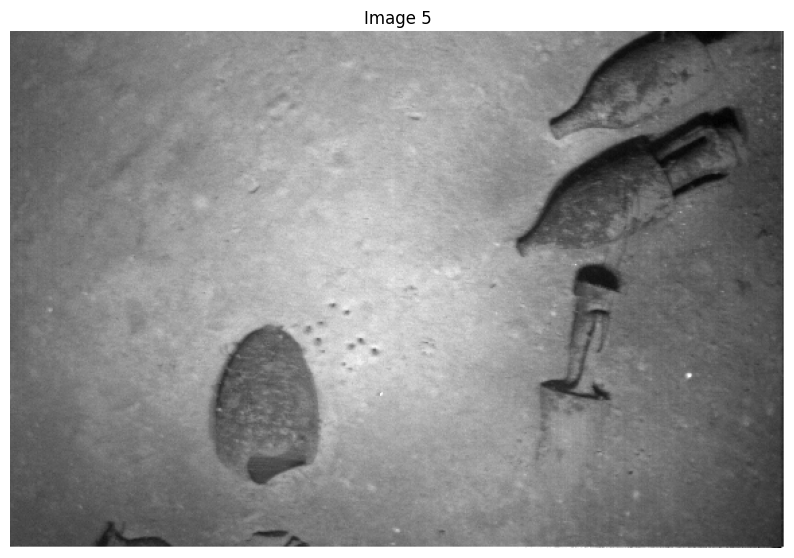

...

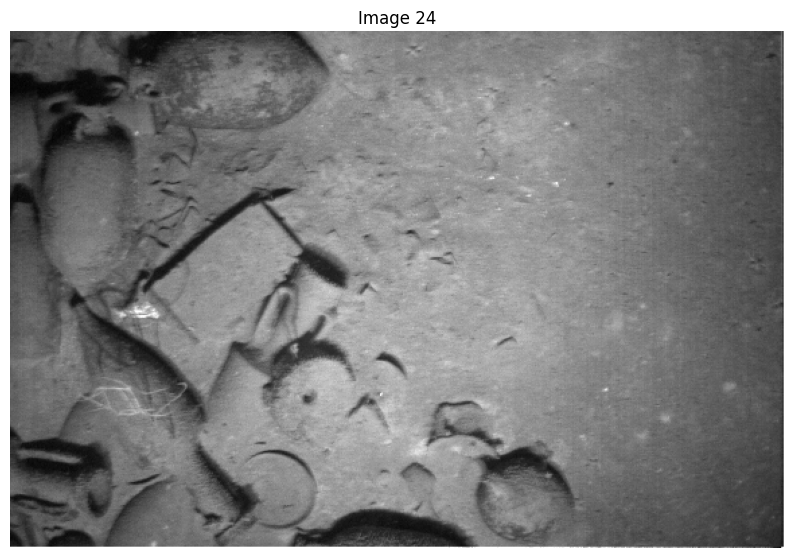

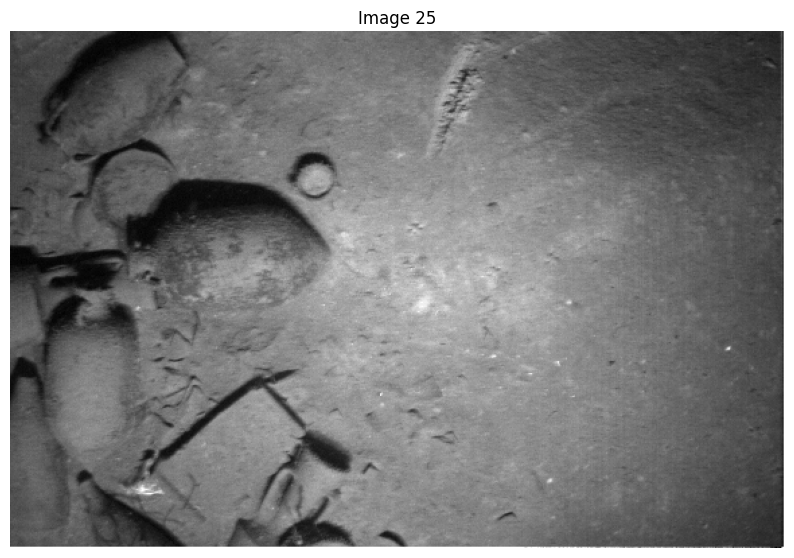

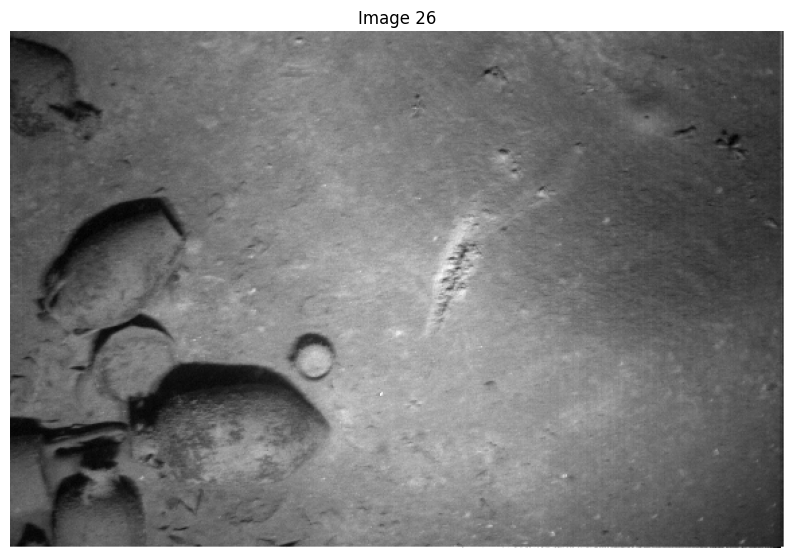

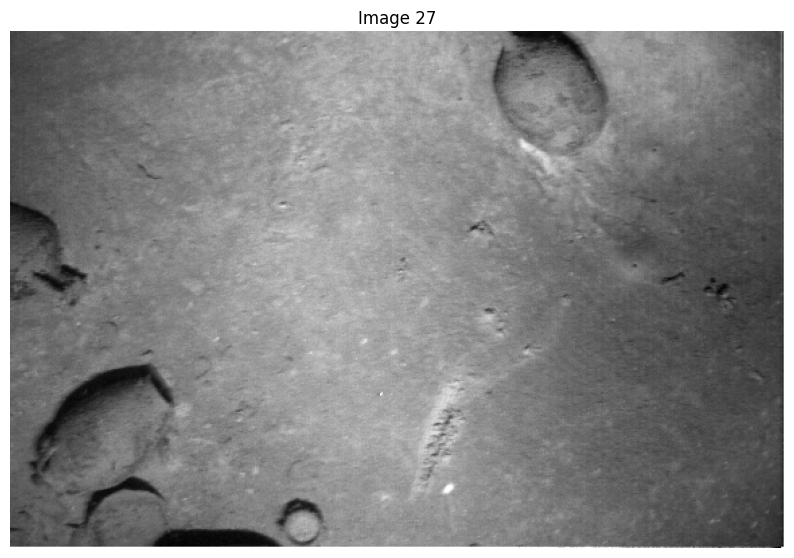

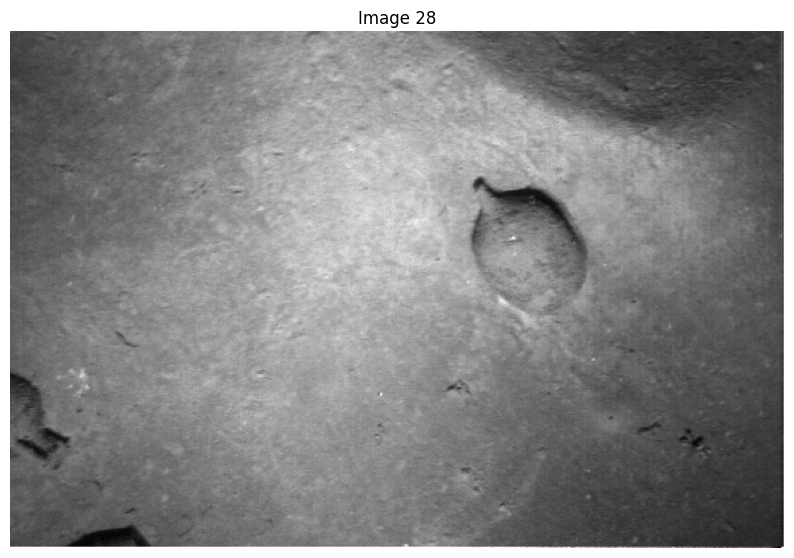

In [ ]:
matcher = ImageFeatureMatching() #class instance
image_dir = '.'

#for reading images using key
def img_sort_key(filename):
    basename = os.path.basename(filename)

    if basename.startswith('img_') and basename.endswith('.tif'):
        num = int(basename.split('_')[1].split('.')[0])
        return num
    else:
        return float('inf') #if no file found

# sort files read
img_files = glob.glob(os.path.join(image_dir, "img_*.tif"))
image_paths = sorted(img_files, key=img_sort_key)

print(f"Found {len(image_paths)} images in sequence:")
for i, path in enumerate(image_paths):
    print(f"{i+1:2d}: {os.path.basename(path)}")

#verify if images=28
if len(image_paths) != 28:
    print(f"\nExpected 28 images, but found {len(image_paths)}")
else:
    print(f"\nAll 28 images found and sorted correctly.")

#read image function
images = matcher.read_image(image_paths, titles=[f"Image {i+1}" for i in range(len(image_paths))])

Sequential matching for 28 images

Matching Image 1 and Image 2
Detected 69 features in 1st image
Detected 91 features in 2nd image
Found 5 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 5
Inliers: 4
Outliers rejected: 1

Homography for this pair found in RANSAC:
[[ 1.01482575e+00 -8.71946853e-05  1.10613755e+01]
 [ 8.71946853e-05  1.01482575e+00 -1.25503557e+02]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 
 Residual sigma2: 0.06, sqrt: 0.25 pixels

Image Feature Matching done
Final inlier ratio: 80.00%
4/5 inliers (80.0%)

Matching Image 2 and Image 3
Detected 91 features in 1st image
Detected 114 features in 2nd image
Found 22 good matches after Lowe's ratio test
RANSAC Results:
Total matches: 22
Inliers: 15
Outliers rejected: 7

Homography for this pair found in RANSAC:
[[ 1.02450957e+00 -3.28404077e-02  1.24532668e+01]
 [ 3.28404077e-02  1.02450957e+00 -1.40857111e+02]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]] 
 Residual sigma2: 1.81, sqrt: 1.

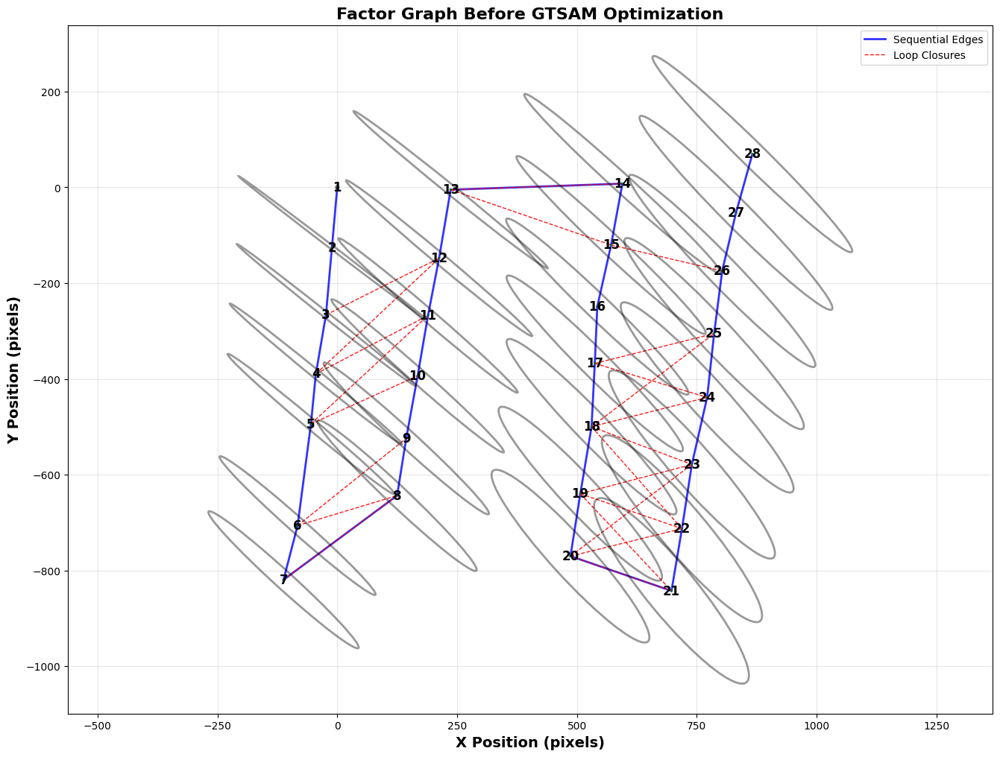

Node 1: (-0.0, 0.0, 0.0°)
Node 2: (-11.1, -125.5, 0.0°)
Node 3: (-23.5, -266.4, 1.8°)
Node 4: (-44.9, -389.6, 3.0°)
Node 5: (-53.2, -496.0, -2.0°)
Node 6: (-90.5, -707.0, -6.2°)
Node 7: (-128.4, -814.0, -6.3°)
Node 8: (131.2, -666.1, -12.0°)
Node 9: (167.5, -550.7, -10.9°)
Node 10: (208.0, -424.4, -7.9°)
Node 11: (235.0, -299.5, -6.2°)
Node 12: (258.3, -183.0, -6.4°)
Node 13: (283.1, -40.1, -7.7°)
Node 14: (643.2, -22.8, -4.3°)
Node 15: (621.7, -144.1, -4.0°)
Node 16: (591.5, -272.2, -4.3°)
Node 17: (585.5, -390.7, -4.2°)
Node 18: (579.2, -522.1, -3.2°)
Node 19: (559.9, -663.5, -4.2°)
Node 20: (539.8, -793.5, -4.2°)
Node 21: (749.8, -866.7, -4.0°)
Node 22: (765.7, -737.5, -3.1°)
Node 23: (778.3, -602.5, -3.6°)
Node 24: (802.5, -461.0, -3.8°)
Node 25: (808.3, -327.3, -4.4°)
Node 26: (817.7, -195.6, -4.7°)
Node 27: (840.2, -73.0, -6.1°)
Node 28: (867.9, 51.3, -6.9°)

Marginal Covariances per node:
Node 0 covariance:
[[ 1.00000000e-02 -2.57836829e-22  6.21724894e-20]
 [-2.57836829e-22  1.

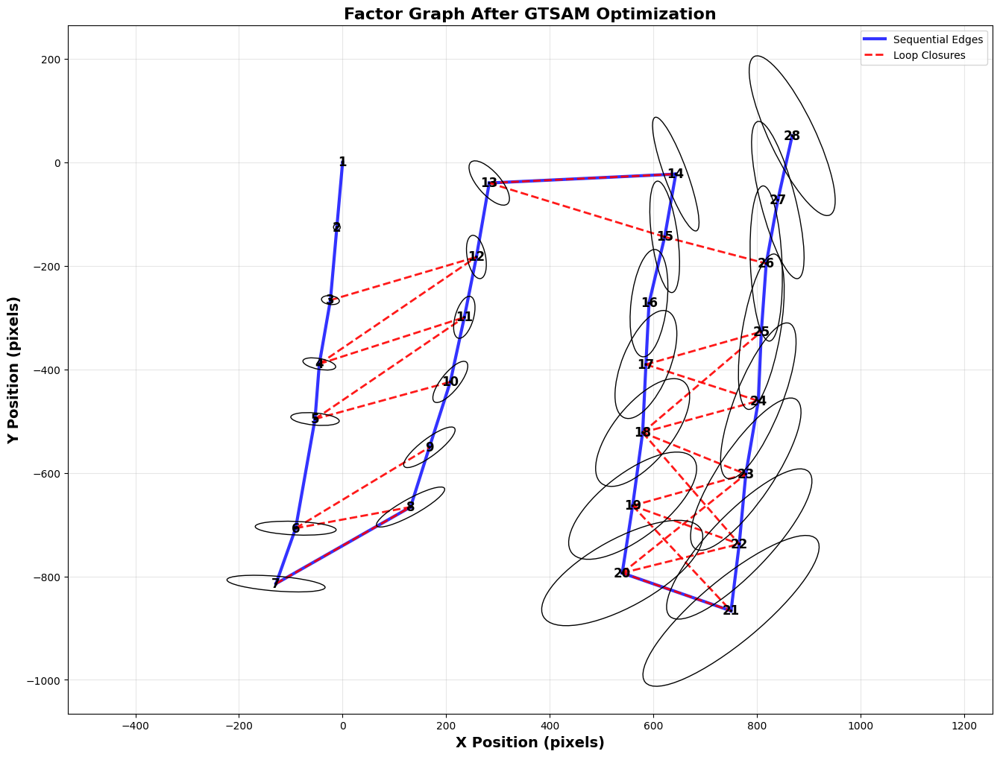

Creating mosaic with Image 1 as reference...
Canvas size: 1589 x 1457
Creating mosaic with GTSAM-optimized poses...
Canvas size: 1721 x 1514


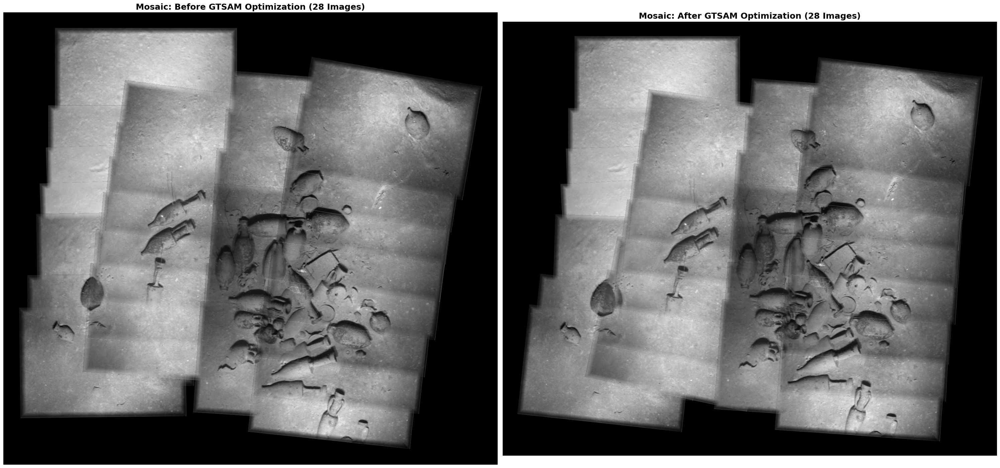


 RESULTS:
Node  1: dx=  -0.0, dy=  +0.0 (distance:   0.0px)
Node  2: dx=  -0.0, dy=  +0.0 (distance:   0.0px)
Node  3: dx=  +0.0, dy=  +0.0 (distance:   0.0px)
Node  4: dx=  -0.4, dy=  -0.0 (distance:   0.4px)
Node  5: dx=  +1.7, dy=  -1.9 (distance:   2.5px)
Node  6: dx=  -7.8, dy=  -0.6 (distance:   7.8px)
Node  7: dx= -16.4, dy=  +5.6 (distance:  17.3px)
Node  8: dx=  +6.3, dy= -22.4 (distance:  23.2px)
Node  9: dx= +23.6, dy= -26.4 (distance:  35.4px)
Node 10: dx= +40.2, dy= -30.7 (distance:  50.6px)
Node 11: dx= +45.6, dy= -32.0 (distance:  55.7px)
Node 12: dx= +45.8, dy= -35.0 (distance:  57.6px)
Node 13: dx= +46.4, dy= -35.1 (distance:  58.2px)
Node 14: dx= +48.2, dy= -30.6 (distance:  57.1px)
Node 15: dx= +50.4, dy= -23.6 (distance:  55.6px)
Node 16: dx= +48.9, dy= -23.2 (distance:  54.1px)
Node 17: dx= +48.2, dy= -23.0 (distance:  53.4px)
Node 18: dx= +48.6, dy= -22.3 (distance:  53.5px)
Node 19: dx= +52.8, dy= -23.6 (distance:  57.8px)
Node 20: dx= +53.2, dy= -23.4 (distance

In [ ]:
# SEQUENTIAL MATCHING (img_1, img_2, img_3,...,img_28)
sequential_results = []
successful_pairs = 0

print("Sequential matching for 28 images")

for i in range(len(images) - 1):
    print(f"\nMatching Image {i+1} and Image {i+2}")
    try:
        result = matcher.register_image_pair(images[i], images[i + 1], visualize=False)

        # if result => success
        success = result['success']
        if success:
            successful_pairs += 1
            print(f"{result['inlier_count']}/{result['total_matches']} inliers ({result['inlier_ratio']:.1%})")
        else:
            print(f"Failed: {result['error']}")

        sequential_results.append({
            'pair': (i, i+1),
            'pair_name': f"{i+1}-{i+2}",
            'result': result,
            'success': success
        })

    except Exception as e:
        print(f"Exception occurred: {e}")
        sequential_results.append({
            'pair': (i, i+1),
            'pair_name': f"{i+1}-{i+2}",
            'result': {'success': False, 'error': str(e)},
            'success': False
        })

###################################
# NON-SEQUENTIAL MATCHING

non_sequential_pairs = [
    (4, 7), (4, 8), (4, 9),
    (5, 7), (5, 8), (5, 9),
    (6, 7), (6, 8), (6, 9),

    (10, 13), (10, 14), (10, 15),
    (11, 13), (11, 14), (11, 15),
    (12, 13), (12, 14), (12, 15),

    (17, 20), (17, 21), (17, 22),
    (18, 20), (18, 21), (18, 22),
    (19, 20), (19, 21), (19, 22),

    (3, 10), (3, 11), (4, 10), (4, 11),
    (16, 23), (16, 24), (17, 23), (17, 24),

    (15, 25), (15, 26),
    (14, 25),
    (2, 11), (2, 12),
    (10, 16),
]

non_sequential_results = []
loop_closure_pairs = 0
min_inlier_ratio = 0.4

print(f"\nNon Sequential Matching using {len(non_sequential_pairs)} pairs")

for idx, (i, j) in enumerate(non_sequential_pairs):
    print(f"\n[{idx+1}/{len(non_sequential_pairs)}] Matching non-sequential Image {i+1} and Image {j+1}")
    try:
        result = matcher.register_image_pair(images[i], images[j], visualize=False)

        # Loop closure => if homography and inlier ratio > 0.4
        if result['success'] and result['inlier_ratio'] >= min_inlier_ratio:
            loop_closure_pairs += 1
            print(f"  Loop Closure: {result['inlier_count']}/{result['total_matches']} inliers ({result['inlier_ratio']:.1%} >= {min_inlier_ratio:.0%})")
            is_loop_closure = True
        elif result['success']:
            print(f"  No Loop Closure: {result['inlier_count']}/{result['total_matches']} inliers ({result['inlier_ratio']:.1%} < {min_inlier_ratio:.0%})")
            is_loop_closure = False
        else:
            print(f" Failed: {result['error']}")
            is_loop_closure = False

        non_sequential_results.append({
            'pair': (i, j),
            'pair_name': f"{i+1}-{j+1}",
            'result': result,
            'success': result['success'] and result['inlier_ratio'] >= min_inlier_ratio,
            'is_potential_loop_closure': is_loop_closure
        })

    except Exception as e:
        print(f"  Exception occurred: {e}")
        non_sequential_results.append({
            'pair': (i, j),
            'pair_name': f"{i+1}-{j+1}",
            'result': {'success': False, 'error': str(e)},
            'success': False,
            'is_potential_loop_closure': False
        })

###################################
# SUMMARY

print(f"\nSequential Pairs ({successful_pairs}/{len(sequential_results)} successful):")
failed_sequential = []
for i, pair_info in enumerate(sequential_results):
    if pair_info['success']:
        result = pair_info['result']
        ratio = result['inlier_ratio']
        count = result['inlier_count']
        total = result['total_matches']
        print(f"  img_{i+1:2d} and img_{i+2:2d}: {ratio:.1%} (inliers: {count:3d}/{total:3d})")
    else:
        failed_sequential.append(f"img_{i+1} and img_{i+2}")
        print(f"  img_{i+1:2d} and img_{i+2:2d}: FAILED")

if failed_sequential:
    print(f"\nFailed sequential pairs: {', '.join(failed_sequential)}")

print(f"\nNon-sequential Pairs:")
for pair_info in non_sequential_results:
    i, j = pair_info['pair']
    if pair_info['result']['success']:
        result = pair_info['result']
        ratio = result['inlier_ratio']
        count = result['inlier_count']
        total = result['total_matches']
        status = "Loop Closure" if pair_info['success'] else "No Loop Closure"
        print(f"  img_{i+1:2d} and img_{j+1:2d}: {ratio:.1%} (inliers: {count:3d}/{total:3d}) - {status}")
    else:
        print(f"  img_{i+1:2d} and img_{j+1:2d}: FAILED")

###################################
# FACTOR GRAPH CONSTRUCTION

factor_graph_data = matcher.plot_complete_factor_graph(
    sequential_results,
    non_sequential_results,
    save_path='factor_graph_28_images_before_gtsam.png')

###################################
# GTSAM OPTIMIZATION

optimized_poses, optimized_covariances = matcher.solve_with_gtsam(
    factor_graph_data['vertices'],
    factor_graph_data['edges']
)

matcher.plot_after_gtsam_optimization(
    optimized_poses,
    optimized_covariances,
    factor_graph_data['edges'],
    save_path='factor_graph_28_images_after_gtsam.png'
)

###################################
# MOSAIC

mosaic = matcher.create_mosaic_with_image1_reference(images, sequential_results)

optimized_mosaic = matcher.create_mosaic_with_gtsam_poses(images, optimized_poses, sequential_results)

###################################
# MOSAIC COMPARISON

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(30, 15))

ax1.imshow(cv2.cvtColor(mosaic, cv2.COLOR_BGR2RGB))
ax1.set_title('Mosaic: Before GTSAM Optimization (28 Images)', fontsize=18, weight='bold')
ax1.axis('off')

ax2.imshow(cv2.cvtColor(optimized_mosaic, cv2.COLOR_BGR2RGB))
ax2.set_title('Mosaic: After GTSAM Optimization (28 Images)', fontsize=18, weight='bold')
ax2.axis('off')

plt.tight_layout()
plt.show()

print('\n RESULTS:')

for i, (initial_pose, optimized_pose) in enumerate(zip(factor_graph_data['vertices'], optimized_poses)):
    dx = optimized_pose[0] - initial_pose[0]
    dy = optimized_pose[1] - initial_pose[1]
    pose_distance = np.sqrt(dx**2 + dy**2)

    print(f"Node {i+1:2d}: dx={dx:+6.1f}, dy={dy:+6.1f} (distance: {pose_distance:5.1f}px)")

#summaries
total_pose_movement = sum([np.sqrt((opt[0]-init[0])**2 + (opt[1]-init[1])**2)
                          for init, opt in zip(factor_graph_data['vertices'], optimized_poses)])

initial_total_uncertainty = sum([np.linalg.det(cov[:2, :2]) for cov in factor_graph_data['vertex_covariances']])
optimized_total_uncertainty = sum([np.linalg.det(cov[:2, :2]) for cov in optimized_covariances])
overall_uncertainty_change = ((optimized_total_uncertainty - initial_total_uncertainty) / initial_total_uncertainty) * 100

print(f"Overall uncertainty reduced: {overall_uncertainty_change:+.1f}%")

## Method explained for more understanding:

### Homography Projection Equations

The projected coordinates $(x_2, y_2)$ using homography matrix $H$ are:

$$
x_2 = \frac{h_{00}x_1 + h_{01}y_1 + h_{02}}{h_{20}x_1 + h_{21}y_1 + 1}
$$

$$
y_2 = \frac{h_{10}x_1 + h_{11}y_1 + h_{12}}{h_{20}x_1 + h_{21}y_1 + 1}
$$

Where the denominator is:
$$
w = h_{20}x_1 + h_{21}y_1 + 1
$$

And the equations in the form:
$$
x_2 = \frac{x_{2h}}{w}, \quad y_2 = \frac{y_{2h}}{w}
$$
Where:
- $x_{2h} = h_{00}x_1 + h_{01}y_1 + h_{02}$
- $y_{2h} = h_{10}x_1 + h_{11}y_1 + h_{12}$

---

### Reprojection Error

$$
\text{residual}_x = x_2^{\text{true}} - x_2
$$

$$
\text{residual}_y = y_2^{\text{true}} - y_2
$$



We now compute the partial derivatives of the reprojection errors:

Each partial derivative tells us how much the reprojection error (the difference between where a point projects versus where it should) changes if we slightly adjust one homography parameter. This helps the optimizer understand which parameters most affect the error, allowing it to update the homography to better align the images.

#### For residual in **x**:

$$
\frac{\partial \text{residual}_x}{\partial h_{00}} = -\frac{x_1}{w}, \quad
\frac{\partial \text{residual}_x}{\partial h_{01}} = -\frac{y_1}{w}, \quad
\frac{\partial \text{residual}_x}{\partial h_{02}} = -\frac{1}{w}
$$

$$
\frac{\partial \text{residual}_x}{\partial h_{20}} = \frac{x_{2h} \cdot x_1}{w^2}, \quad
\frac{\partial \text{residual}_x}{\partial h_{21}} = \frac{x_{2h} \cdot y_1}{w^2}
$$

#### For residual in **y**:

$$
\frac{\partial \text{residual}_y}{\partial h_{10}} = -\frac{x_1}{w}, \quad
\frac{\partial \text{residual}_y}{\partial h_{11}} = -\frac{y_1}{w}, \quad
\frac{\partial \text{residual}_y}{\partial h_{12}} = -\frac{1}{w}
$$


---

### Jacobian Matrix Structure

The Jacobian matrix \( J \) for a single keypoint \( (x_1, y_1) \) has 2 rows (for \( x \) and \( y \) residuals) and 8 columns (one for each homography parameter except the bottom-right, which is fixed to 1):

$$
J = \begin{bmatrix}
\frac{\partial \text{residual}_x}{\partial h_{00}} & \frac{\partial \text{residual}_x}{\partial h_{01}} & \frac{\partial \text{residual}_x}{\partial h_{02}} &
0 & 0 & 0 &
\frac{\partial \text{residual}_x}{\partial h_{20}} & \frac{\partial \text{residual}_x}{\partial h_{21}} \\
0 & 0 & 0 &
\frac{\partial \text{residual}_y}{\partial h_{10}} & \frac{\partial \text{residual}_y}{\partial h_{11}} & \frac{\partial \text{residual}_y}{\partial h_{12}} &
\frac{\partial \text{residual}_y}{\partial h_{20}} & \frac{\partial \text{residual}_y}{\partial h_{21}}
\end{bmatrix}
$$

